In [1]:
import dolfin as dl
import ufl
import numpy as np


from petsc4py import PETSc
import petsc4py, sys
petsc4py.init(sys.argv)
import scipy.sparse as sp

import sys
import os
sys.path.append( os.environ.get('HIPPYLIB_BASE_DIR', "../") )
from hippylib import *

import logging
import math

import matplotlib.pyplot as plt
%matplotlib inline

logging.getLogger('FFC').setLevel(logging.WARNING)
logging.getLogger('UFL').setLevel(logging.WARNING)
dl.set_log_active(False)

# Determine active subspace

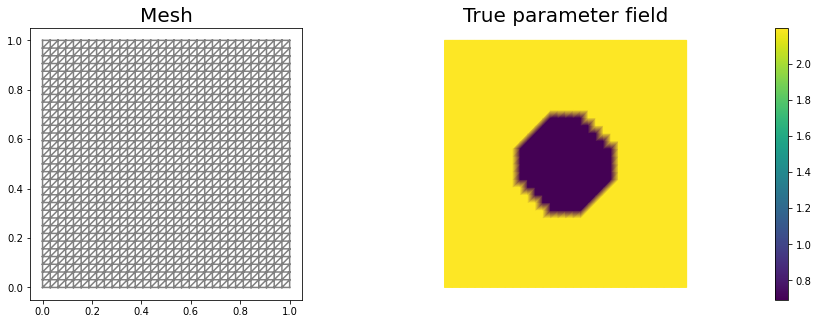

In [2]:
# create mesh and define function spaces
nx = 32
ny = 32
mesh = dl.UnitSquareMesh(nx, ny)
Vm = dl.FunctionSpace(mesh, 'Lagrange', 1)
Vu = dl.FunctionSpace(mesh, 'Lagrange', 2)

# The true and inverted parameter
mtrue_expression = dl.Expression('std::log(2 + 7*(std::pow(std::pow(x[0] - 0.5,2) + std::pow(x[1] - 0.5,2),0.5) > 0.2))', degree=5)

# mtrue_expression = dl.Expression('std::log(9 + 7*(std::pow(std::pow(x[0] - 0.5,2),0.5) <= 0.2001))', degree=5)

mtrue = dl.interpolate(mtrue_expression,Vm)
m = dl.interpolate(dl.Expression("std::log(2.0)", degree=1),Vm)

# define function for state and adjoint
u = dl.Function(Vu)
p = dl.Function(Vu)

# define Trial and Test Functions
u_trial, p_trial, m_trial = dl.TrialFunction(Vu), dl.TrialFunction(Vu), dl.TrialFunction(Vm)
u_test, p_test, m_test = dl.TestFunction(Vu), dl.TestFunction(Vu), dl.TestFunction(Vm)

# initialize input functions
f = dl.Constant(1.0)
u0 = dl.Constant(0.0)

# set up dirichlet boundary conditions
def boundary(x,on_boundary):
    return on_boundary

bc_state = dl.DirichletBC(Vu, u0, boundary)
bc_adj = dl.DirichletBC(Vu, dl.Constant(0.), boundary)

# noise level
noise_level = 0.05

# weak form for setting up the synthetic observations
a_goal = ufl.inner(ufl.exp(mtrue) * ufl.grad(u_trial), ufl.grad(u_test)) * ufl.dx
L_goal = f * u_test * ufl.dx

# solve the forward/state problem to generate synthetic observations
goal_A, goal_b = dl.assemble_system(a_goal, L_goal, bc_state)

utrue = dl.Function(Vu)
dl.solve(goal_A, utrue.vector(), goal_b)

ud = dl.Function(Vu)
ud.assign(utrue)

# perturb state solution and create synthetic measurements ud
# ud = u + ||u||/SNR * random.normal
MAX = ud.vector().norm("linf")
noise = dl.Vector()
goal_A.init_vector(noise,1)
parRandom.normal(noise_level * MAX, noise)
bc_adj.apply(noise)

ud.vector().axpy(1., noise)

# plot
plt.figure(figsize=(15,5))
nb.plot(mesh,subplot_loc=121, mytitle="Mesh", show_axis='on')
nb.plot(mtrue,subplot_loc=122, mytitle="True parameter field")
plt.show()

In [3]:
beta = 100
2*10*nx*ny

20480

In [4]:
n_active_ss_samples = 2*10*nx*ny*5

# weak form for setting up the state equation
a_state = dl.inner(dl.exp(m) * dl.grad(u_trial), dl.grad(u_test)) * dl.dx
L_state = f * u_test * dl.dx

# weak form for setting up the adjoint equation
a_adj = dl.inner(dl.exp(m) * dl.grad(p_trial), dl.grad(p_test)) * dl.dx
L_adj = -dl.inner(u - ud, p_test) * dl.dx

# weak form for gradient
CTvarf    = dl.inner(dl.exp(m)*m_test*dl.grad(u), dl.grad(p)) * dl.dx

# form the prior C, m^{T} C^{-1} m, and draw paramters m(i)

Mvarf    = (ufl.inner(ufl.grad(m_trial), ufl.grad(m_test)) * ufl.dx + ufl.inner(m_trial, m_test) * ufl.dx)
# We introduce the ||m||^{2} + ||\Grad{m}||^{2} to overcome ill-posed of C^{-1}

Mass =  dl.assemble(Mvarf).array()

# C^{-1} = L L^{T}
UU, SSS, VVH = np.linalg.svd(Mass);
M_half = UU @ np.diag(np.sqrt(SSS)) @ VVH
M_half_inv = np.linalg.inv(M_half)

# Change of variable: m = m_{0} + L_inv^{T} m_{tidle}, where 
m_sample = M_half_inv.T @ np.random.standard_normal(size = ((nx+1)*(ny+1),n_active_ss_samples))


# create storage for gradient to be used later
grad = np.zeros(shape = m_sample.shape)
C_grad = np.zeros(((nx+1)*(ny+1),(nx+1)*(ny+1)))
G = np.zeros(shape = m_sample.shape)

## Solving to find gradient of corresponding sample
# Note that: we solve problem without regularization term
for ind, mi in enumerate(m_sample.T):
    if ind % 200 == 0: print(ind)
        
    # step 1: solve the forward model - needs to be in the loop
    # because we need to calculate N gradients 

    m.vector().set_local(mi)
    # print(mi)
    # print(np.linalg.norm(mi))
    
    A, state_b = dl.assemble_system (a_state, L_state, bc_state)
    dl.solve(A, u.vector(), state_b)
    
    # print(u.vector().get_local()) 
    # print(np.linalg.norm(u.vector().get_local()))
    
    # step 2: solve adjoint equation
    adj_A, adjoint_RHS = dl.assemble_system(a_adj, L_adj, bc_adj)
    dl.solve(adj_A, p.vector(), adjoint_RHS)
    
    # print(p.vector().get_local())
    # print(np.linalg.norm(p.vector().get_local()))
    
    # step 3: compute the gradient and store in matrix for later
    grad = dl.assemble(CTvarf).get_local()
    
    Grad = np.asarray(grad.reshape(((nx+1)*(ny+1),1)))
    
    # G = np.hstack((G,Grad))
    
    # Step 4: Compute the active subspace matrix
    C_grad += Grad @ Grad.T / n_active_ss_samples
    
# Step 5: Eigendecomposition
UU,SS,VH = np.linalg.svd(C_grad)
WW = VH.T
print("SVD complete")

0
200
400
600
800
1000
1200
1400
1600
1800
2000
2200
2400
2600
2800
3000
3200
3400
3600
3800
4000
4200
4400
4600
4800
5000
5200
5400
5600
5800
6000
6200
6400
6600
6800
7000
7200
7400
7600
7800
8000
8200
8400
8600
8800
9000
9200
9400
9600
9800
10000
10200
10400
10600
10800
11000
11200
11400
11600
11800
12000
12200
12400
12600
12800
13000
13200
13400
13600
13800
14000
14200
14400
14600
14800
15000
15200
15400
15600
15800
16000
16200
16400
16600
16800
17000
17200
17400
17600
17800
18000
18200
18400
18600
18800
19000
19200
19400
19600
19800
20000
20200
20400
20600
20800
21000
21200
21400
21600
21800
22000
22200
22400
22600
22800
23000
23200
23400
23600
23800
24000
24200
24400
24600
24800
25000
25200
25400
25600
25800
26000
26200
26400
26600
26800
27000
27200
27400
27600
27800
28000
28200
28400
28600
28800
29000
29200
29400
29600
29800
30000
30200
30400
30600
30800
31000
31200
31400
31600
31800
32000
32200
32400
32600
32800
33000
33200
33400
33600
33800
34000
34200
34400
34600
34800
35000
3

In [5]:
print(type(C_grad))
C_grad.shape

<class 'numpy.ndarray'>


(1089, 1089)

(1089,)
[1.05264074e-05 6.19178228e-07 3.90722999e-07 3.15757127e-07
 1.35851407e-07 1.09349492e-07 9.36852269e-08 7.09751469e-08
 5.09723549e-08 4.13461823e-08]


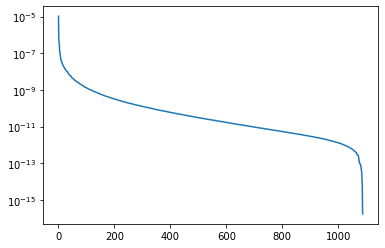

In [6]:
UU,S,VH = np.linalg.svd(C_grad)
WW = VH.T
print(S.shape)
plt.semilogy((S))
print(S[:10])

0
1
2
3
4
5
6
7
8
9


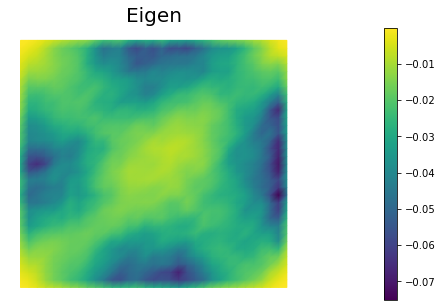

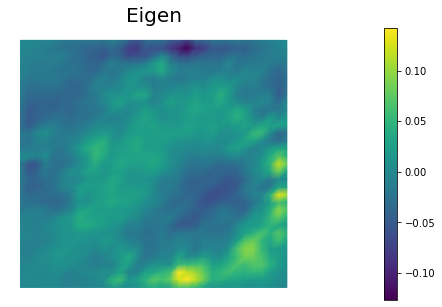

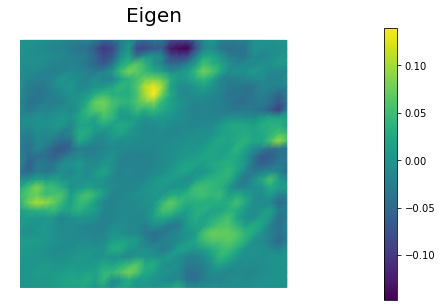

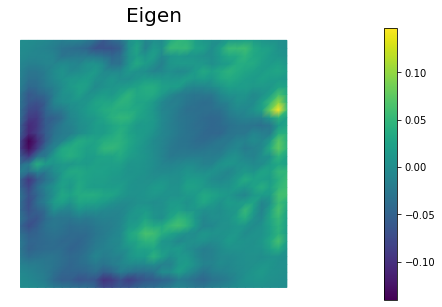

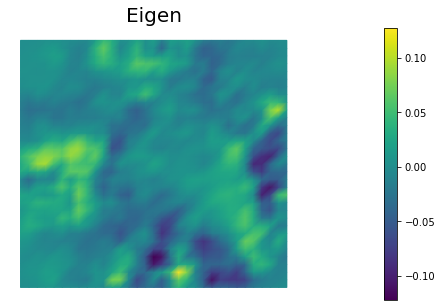

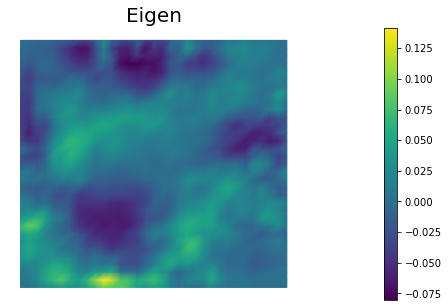

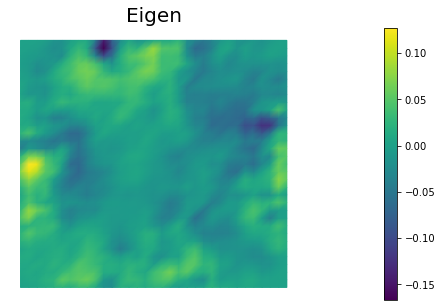

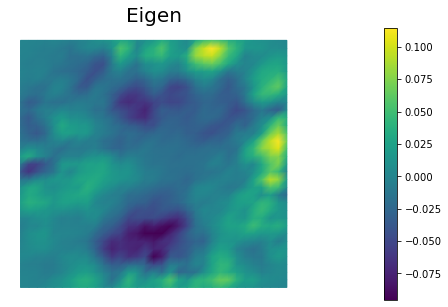

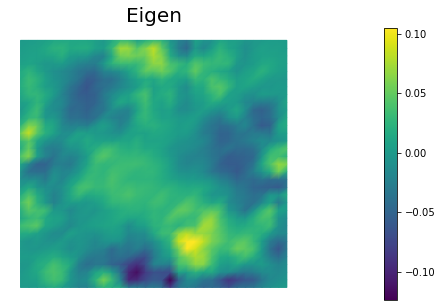

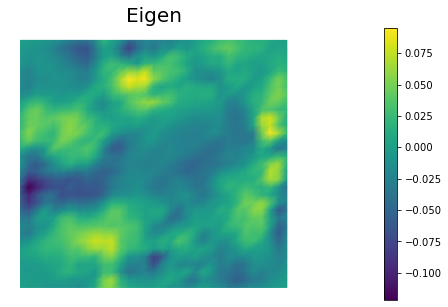

In [7]:
for r_dim in range(10):
    print(r_dim)
    m_vec = dl.Function(Vm)
    m_vec.vector().set_local(WW[:,r_dim])
    nb.multi1_plot([m_vec], ['Eigen'],same_colorbar=False)

Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.24451e-05   1.14009e-05   1.04426e-06   1.56017e-02   3.78745e-04    1.00   5.000e-01
 2     1     2.72145e-06   8.96331e-07   1.82512e-06   4.54197e-03   5.22529e-05    1.00   3.714e-01
 3     1     2.43489e-06   3.60524e-07   2.07436e-06   7.78901e-04   5.78154e-06    1.00   1.236e-01
 4     3     2.43279e-06   3.54640e-07   2.07815e-06   6.47915e-05   4.76594e-07    1.00   3.547e-02
 5     3     2.43279e-06   3.55031e-07   2.07776e-06   1.59358e-06   1.94144e-08    1.00   7.160e-03
 6     4     2.43279e-06   3.55002e-07   2.07779e-06   8.08663e-08   6.31523e-10    1.00   1.291e-03
 7     3     2.43279e-06   3.55003e-07   2.07779e-06   6.57768e-11   4.96439e-13    1.00   3.620e-05
Newton's method converged in  7   iterations
Total number of CG iterations:  16
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.1334

 2     1     8.15844e-07   7.88577e-07   2.72671e-08   4.93258e-03   5.61422e-05    1.00   3.841e-01
 3     1     2.43059e-07   2.18242e-07   2.48168e-08   1.07348e-03   1.11804e-05    1.00   1.714e-01
 4     4     1.90675e-07   1.89516e-07   1.15936e-09   3.24263e-04   8.01323e-06    1.00   1.451e-01
 5     8     1.90071e-07   1.89060e-07   1.01080e-09   3.52083e-05   3.32274e-07    1.00   2.955e-02
 6     8     1.90065e-07   1.89061e-07   1.00440e-09   3.41294e-06   1.44209e-08    1.00   6.156e-03
 7    11     1.90065e-07   1.89060e-07   1.00501e-09   3.65006e-08   3.25338e-10    1.00   9.247e-04
 8     6     1.90065e-07   1.89060e-07   1.00501e-09   2.39149e-11   3.15274e-13    0.12   2.879e-05
Newton's method converged in  8   iterations
Total number of CG iterations:  40
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.24676e-05   1.24369e-05   3.07092e-08   1.56305e-02   3.80668e-04    1.00   5.000e-01
 2     1     8.

 6     8     1.47465e-07   1.46993e-07   4.71726e-10   1.24998e-05   7.72992e-08    1.00   1.426e-02
 7    14     1.47465e-07   1.46994e-07   4.70850e-10   1.06359e-06   3.95723e-09    1.00   3.228e-03
 8    14     1.47465e-07   1.46994e-07   4.70853e-10   5.55629e-09   3.02500e-11    1.00   2.822e-04
Newton's method converged in  8   iterations
Total number of CG iterations:  52
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.22338e-05   1.22136e-05   2.01810e-08   1.56105e-02   3.79845e-04    1.00   5.000e-01
 2     1     7.94531e-07   7.75834e-07   1.86974e-08   4.88920e-03   5.57671e-05    1.00   3.832e-01
 3     1     2.25317e-07   2.07747e-07   1.75704e-08   1.06970e-03   1.13270e-05    1.00   1.727e-01
 4     4     1.51897e-07   1.51027e-07   8.70022e-10   3.97707e-04   8.42897e-06    1.00   1.490e-01
 5     9     1.46161e-07   1.45766e-07   3.94466e-10   1.41326e-04   1.04182e-06    1.00   5.237e-02
 6     3     1.

 3     1     2.31233e-07   2.15272e-07   1.59610e-08   1.04442e-03   1.11500e-05    1.00   1.713e-01
 4     6     1.41484e-07   1.41320e-07   1.64482e-10   4.55672e-04   8.25652e-06    1.00   1.474e-01
 5     6     1.29297e-07   1.29196e-07   1.01124e-10   1.57755e-04   8.55418e-07    1.00   4.746e-02
 6     9     1.28880e-07   1.28770e-07   1.10404e-10   2.81413e-05   2.18484e-07    1.00   2.398e-02
 7    15     1.28866e-07   1.28756e-07   1.10400e-10   5.20333e-06   2.77683e-08    1.00   8.550e-03
 8    15     1.28866e-07   1.28756e-07   1.10316e-10   3.53589e-07   1.58505e-09    1.00   2.043e-03
 9    29     1.28866e-07   1.28756e-07   1.10316e-10   3.04965e-09   2.43178e-11    1.00   2.530e-04
Newton's method converged in  9   iterations
Total number of CG iterations:  83
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.21893e-05   1.21713e-05   1.79808e-08   1.56236e-02   3.80136e-04    1.00   5.000e-01
 2     1     7.

 9    32     1.23174e-07   1.23129e-07   4.50927e-11   6.76712e-09   1.02292e-11    1.00   1.640e-04
Newton's method converged in  9   iterations
Total number of CG iterations:  94
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.22242e-05   1.22066e-05   1.76113e-08   1.56013e-02   3.79744e-04    1.00   5.000e-01
 2     1     7.79096e-07   7.62458e-07   1.66378e-08   4.88601e-03   5.58255e-05    1.00   3.834e-01
 3     1     2.36046e-07   2.20254e-07   1.57922e-08   1.04435e-03   1.09295e-05    1.00   1.697e-01
 4     4     1.27219e-07   1.26828e-07   3.90885e-10   4.76988e-04   8.03070e-06    1.00   1.454e-01
 5    14     1.22204e-07   1.22149e-07   5.46324e-11   1.13664e-04   7.02609e-07    1.00   4.301e-02
 6     7     1.21151e-07   1.21105e-07   4.60861e-11   4.58205e-05   2.39633e-07    1.00   2.512e-02
 7    23     1.21137e-07   1.21090e-07   4.70290e-11   5.21376e-06   8.87460e-09    1.00   4.834e-03
 8    16     1.

10    27     1.12488e-07   1.12477e-07   1.17687e-11   2.89422e-10   1.43157e-12    0.50   6.138e-05
Newton's method converged in  10   iterations
Total number of CG iterations:  115
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.24498e-05   1.24331e-05   1.66551e-08   1.56070e-02   3.80093e-04    1.00   5.000e-01
 2     1     7.99285e-07   7.83440e-07   1.58454e-08   4.93081e-03   5.63942e-05    1.00   3.852e-01
 3     1     2.42468e-07   2.27424e-07   1.50445e-08   1.05769e-03   1.09592e-05    1.00   1.698e-01
 4     4     1.25036e-07   1.24662e-07   3.73658e-10   4.92981e-04   7.99486e-06    1.00   1.450e-01
 5    15     1.21856e-07   1.21842e-07   1.42677e-11   1.46686e-04   9.70951e-07    1.00   5.054e-02
 6     3     1.14993e-07   1.14979e-07   1.40776e-11   1.18976e-04   6.47573e-07    1.00   4.128e-02
 7    22     1.14836e-07   1.14822e-07   1.36938e-11   1.94789e-05   5.96834e-08    1.00   1.253e-02
 8    16     

 5    11     1.18917e-07   1.18900e-07   1.70810e-11   1.60267e-04   1.30009e-06    1.00   5.854e-02
 6     3     1.12649e-07   1.12642e-07   7.36124e-12   1.13874e-04   6.31936e-07    1.00   4.081e-02
 7    28     1.12505e-07   1.12501e-07   4.34953e-12   2.74708e-05   8.63969e-08    1.00   1.509e-02
 8     8     1.12337e-07   1.12333e-07   4.29608e-12   1.81503e-05   9.52344e-08    1.00   1.584e-02
 9    37     1.12332e-07   1.12327e-07   4.29300e-12   3.42718e-06   2.58965e-09    1.00   2.613e-03
10    19     1.12332e-07   1.12327e-07   4.29298e-12   2.97381e-07   1.62248e-09    1.00   2.068e-03
11    42     1.12332e-07   1.12327e-07   4.29295e-12   3.10601e-09   4.95720e-12    1.00   1.143e-04
Newton's method converged in  11   iterations
Total number of CG iterations:  155
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.24718e-05   1.24558e-05   1.59905e-08   1.55905e-02   3.79717e-04    1.00   5.000e-01
 2     1     

10    22     1.10356e-07   1.10350e-07   5.39938e-12   1.13722e-06   5.37358e-09    1.00   3.760e-03
11    43     1.10356e-07   1.10350e-07   5.39920e-12   5.89924e-08   7.42608e-11    1.00   4.420e-04
Newton's method converged in  11   iterations
Total number of CG iterations:  169
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.25410e-05   1.25254e-05   1.55861e-08   1.55933e-02   3.79871e-04    1.00   5.000e-01
 2     1     8.10922e-07   7.95957e-07   1.49654e-08   4.94763e-03   5.66267e-05    1.00   3.861e-01
 3     1     2.47624e-07   2.33372e-07   1.42529e-08   1.06399e-03   1.08403e-05    1.00   1.689e-01
 4     4     1.20835e-07   1.20139e-07   6.96129e-10   5.15747e-04   7.82753e-06    1.00   1.435e-01
 5     9     1.11281e-07   1.11277e-07   4.44252e-12   1.57918e-04   1.66205e-06    1.00   6.615e-02
 6     4     1.08065e-07   1.08062e-07   3.40371e-12   8.07757e-05   4.24242e-07    1.00   3.342e-02
 7    35     

12    34     1.14886e-07   1.14882e-07   3.50668e-12   5.14498e-10   2.47371e-12    1.00   8.072e-05
Newton's method converged in  12   iterations
Total number of CG iterations:  211
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.26046e-05   1.25904e-05   1.41355e-08   1.55968e-02   3.79969e-04    1.00   5.000e-01
 2     1     8.21150e-07   8.07544e-07   1.36064e-08   4.95954e-03   5.67476e-05    1.00   3.865e-01
 3     1     2.53195e-07   2.40228e-07   1.29669e-08   1.06848e-03   1.08170e-05    1.00   1.687e-01
 4     4     1.28870e-07   1.28231e-07   6.39385e-10   5.18208e-04   7.79405e-06    1.00   1.432e-01
 5     8     1.14481e-07   1.14440e-07   4.07142e-11   1.81358e-04   1.75279e-06    1.00   6.792e-02
 6     8     1.11882e-07   1.11874e-07   8.27695e-12   7.27240e-05   5.35149e-07    1.00   3.753e-02
 7    33     1.11431e-07   1.11426e-07   5.13680e-12   3.68582e-05   1.08556e-07    0.50   1.690e-02
 8    16     

Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.26184e-05   1.26050e-05   1.33653e-08   1.56026e-02   3.80112e-04    1.00   5.000e-01
 2     1     8.11131e-07   7.98230e-07   1.29013e-08   4.96520e-03   5.68036e-05    1.00   3.866e-01
 3     1     2.42072e-07   2.29764e-07   1.23080e-08   1.06955e-03   1.08319e-05    1.00   1.688e-01
 4     5     1.17868e-07   1.17635e-07   2.33527e-10   5.10106e-04   7.81243e-06    1.00   1.434e-01
 5    13     1.15242e-07   1.15237e-07   4.87899e-12   1.33814e-04   1.17216e-06    1.00   5.553e-02
 6     3     1.08952e-07   1.08948e-07   4.04480e-12   1.14074e-04   6.07739e-07    1.00   3.999e-02
 7    76     1.08847e-07   1.08843e-07   3.92000e-12   4.93886e-05   5.65939e-08    0.06   1.220e-02
 8    29     1.08636e-07   1.08632e-07   3.54857e-12   2.10251e-05   5.06481e-08    1.00   1.154e-02
 9    14     1.08605e-07   1.08602e-07   3.54352e-12   7.70117e-06   4.01084e-08    1.00   1.02

Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.25817e-05   1.25689e-05   1.27863e-08   1.55812e-02   3.79595e-04    1.00   5.000e-01
 2     1     8.15711e-07   8.03335e-07   1.23761e-08   4.95589e-03   5.67528e-05    1.00   3.867e-01
 3     1     2.49307e-07   2.37491e-07   1.18166e-08   1.06700e-03   1.08621e-05    1.00   1.692e-01
 4     3     1.27330e-07   1.26344e-07   9.86069e-10   5.10918e-04   7.86938e-06    1.00   1.440e-01
 5     9     1.12833e-07   1.12830e-07   2.96675e-12   1.90852e-04   2.29025e-06    1.00   7.767e-02
 6     7     1.08627e-07   1.08625e-07   2.65957e-12   9.11440e-05   4.65606e-07    1.00   3.502e-02
 7    40     1.08056e-07   1.08053e-07   2.29462e-12   4.15903e-05   2.18922e-08    0.50   7.594e-03
 8    18     1.07801e-07   1.07799e-07   2.18397e-12   2.06489e-05   6.68709e-08    1.00   1.327e-02
 9    24     1.07755e-07   1.07753e-07   2.13725e-12   8.97814e-06   2.19984e-08    1.00   7.61

10    22     1.10083e-07   1.10081e-07   2.24363e-12   1.87870e-06   9.27150e-09    1.00   4.938e-03
11    61     1.10083e-07   1.10081e-07   2.24413e-12   1.27507e-07   8.02215e-11    1.00   4.594e-04
Newton's method converged in  11   iterations
Total number of CG iterations:  183
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.25667e-05   1.25540e-05   1.26913e-08   1.55729e-02   3.79403e-04    1.00   5.000e-01
 2     1     8.12871e-07   8.00588e-07   1.22828e-08   4.95301e-03   5.67435e-05    1.00   3.867e-01
 3     1     2.47142e-07   2.35415e-07   1.17271e-08   1.06634e-03   1.08704e-05    1.00   1.693e-01
 4     3     1.27227e-07   1.26256e-07   9.71058e-10   5.04967e-04   7.87366e-06    1.00   1.441e-01
 5     9     1.12388e-07   1.12386e-07   2.60491e-12   1.84974e-04   2.27325e-06    1.00   7.741e-02
 6     8     1.09648e-07   1.09646e-07   2.46089e-12   7.25295e-05   3.58072e-07    1.00   3.072e-02
 7    40     

 6     6     1.14070e-07   1.14067e-07   3.11166e-12   9.61689e-05   4.92686e-07    1.00   3.600e-02
 7    30     1.13797e-07   1.13794e-07   3.06535e-12   1.75491e-04   4.79492e-08    0.02   1.123e-02
 8    19     1.13016e-07   1.13014e-07   2.64509e-12   3.77951e-05   9.43952e-08    1.00   1.576e-02
 9    14     1.12743e-07   1.12741e-07   2.58041e-12   2.12865e-05   9.09194e-08    1.00   1.547e-02
10    31     1.12670e-07   1.12668e-07   2.49442e-12   1.17070e-05   2.00280e-08    1.00   7.259e-03
11    15     1.12651e-07   1.12649e-07   2.47956e-12   5.86159e-06   2.87571e-08    1.00   8.698e-03
12    50     1.12650e-07   1.12647e-07   2.46766e-12   1.76039e-06   2.03153e-09    1.00   2.312e-03
13    34     1.12650e-07   1.12647e-07   2.46743e-12   2.51174e-07   1.30278e-09    1.00   1.851e-03
14    75     1.12650e-07   1.12647e-07   2.46742e-12   5.86502e-09   4.68009e-12    1.00   1.110e-04
Newton's method converged in  14   iterations
Total number of CG iterations:  289
Nit   CGi

13    61     1.05491e-07   1.05490e-07   1.24801e-12   1.74476e-08   5.72833e-11    1.00   3.882e-04
Newton's method converged in  13   iterations
Total number of CG iterations:  263
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.26966e-05   1.26846e-05   1.19754e-08   1.56043e-02   3.80173e-04    1.00   5.000e-01
 2     1     8.30283e-07   8.18669e-07   1.16138e-08   4.97759e-03   5.69190e-05    1.00   3.869e-01
 3     1     2.51921e-07   2.40833e-07   1.10872e-08   1.07834e-03   1.09243e-05    1.00   1.695e-01
 4     4     1.24698e-07   1.23916e-07   7.81511e-10   5.21586e-04   7.91814e-06    1.00   1.443e-01
 5     9     1.11731e-07   1.11703e-07   2.79254e-11   1.89441e-04   2.15659e-06    1.00   7.532e-02
 6     4     1.06421e-07   1.06418e-07   2.96150e-12   1.04977e-04   6.67255e-07    1.00   4.189e-02
 7    29     1.06156e-07   1.06153e-07   3.01908e-12   1.41382e-04   8.07503e-08    0.02   1.457e-02
 8    29     

 5    15     1.02527e-07   1.02493e-07   3.41783e-11   1.50742e-04   1.19345e-06    0.50   5.605e-02
 6    23     1.01126e-07   1.01125e-07   1.41609e-12   7.15553e-05   4.48496e-07    1.00   3.436e-02
 7     8     9.95626e-08   9.95612e-08   1.38989e-12   5.59469e-05   2.86619e-07    1.00   2.747e-02
 8    60     9.94168e-08   9.94155e-08   1.33112e-12   2.25385e-05   1.19498e-08    0.50   5.609e-03
 9    18     9.93357e-08   9.93344e-08   1.31394e-12   1.19415e-05   5.12579e-08    1.00   1.162e-02
10    44     9.93231e-08   9.93218e-08   1.29979e-12   4.93417e-06   6.69915e-09    1.00   4.200e-03
11    25     9.93216e-08   9.93203e-08   1.29961e-12   1.67099e-06   8.75434e-09    1.00   4.801e-03
12    62     9.93216e-08   9.93203e-08   1.29940e-12   1.85716e-07   1.86212e-10    1.00   7.002e-04
13    51     9.93216e-08   9.93203e-08   1.29941e-12   3.46470e-09   1.87008e-11    1.00   2.219e-04
Newton's method converged in  13   iterations
Total number of CG iterations:  314
Nit   CGi

 8     5     1.08617e-07   1.08616e-07   1.28288e-12   4.50586e-05   2.48134e-07    1.00   2.556e-02
 9    66     1.08519e-07   1.08518e-07   1.21635e-12   2.64166e-05   8.75271e-09    0.50   4.800e-03
10    10     1.08339e-07   1.08338e-07   1.20073e-12   1.84632e-05   9.87501e-08    1.00   1.612e-02
11    57     1.08317e-07   1.08316e-07   1.17536e-12   7.67507e-06   3.47454e-09    1.00   3.024e-03
12    14     1.08307e-07   1.08306e-07   1.17499e-12   4.33283e-06   2.48667e-08    1.00   8.091e-03
13    75     1.08307e-07   1.08306e-07   1.17429e-12   3.42374e-07   1.82765e-10    1.00   6.936e-04
14    40     1.08307e-07   1.08306e-07   1.17429e-12   9.85619e-09   5.61708e-11    1.00   3.845e-04
Newton's method converged in  14   iterations
Total number of CG iterations:  322
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.26785e-05   1.26667e-05   1.18104e-08   1.55973e-02   3.79999e-04    1.00   5.000e-01
 2     1     

/oden/hainguyen/.local/lib/python3.9/site-packages/hippylib/utils/nb.py:123: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(15,5))


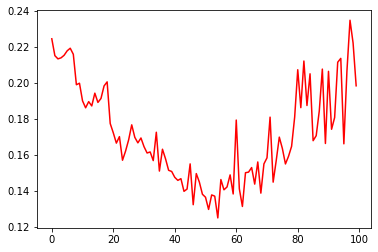

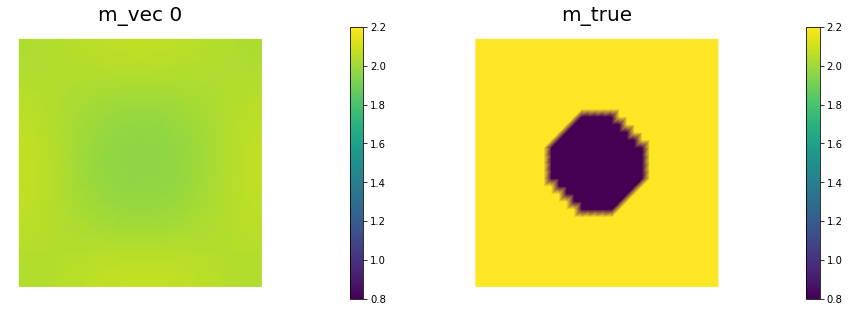

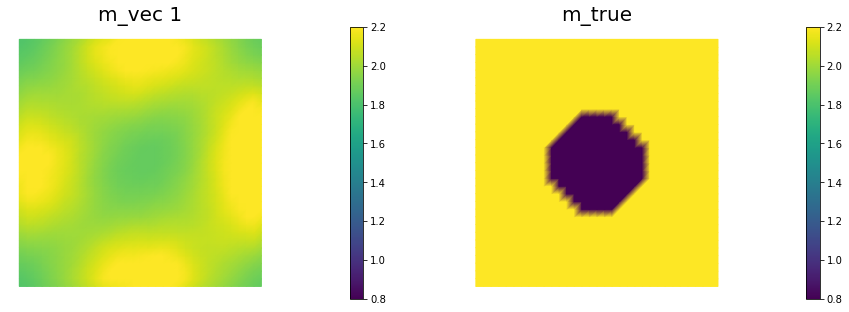

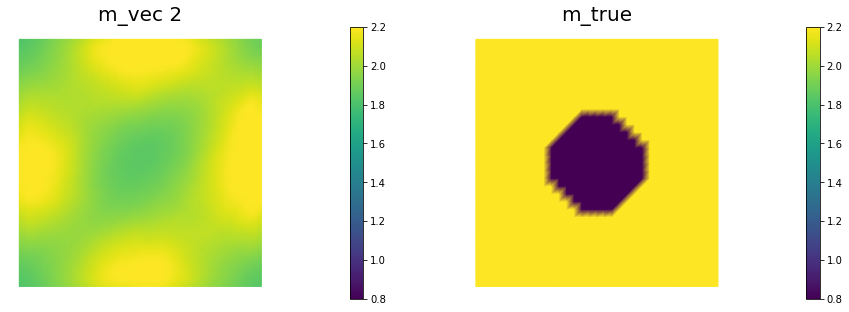

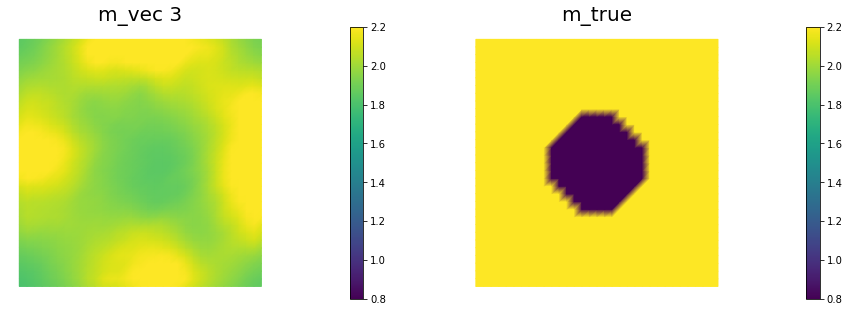

...

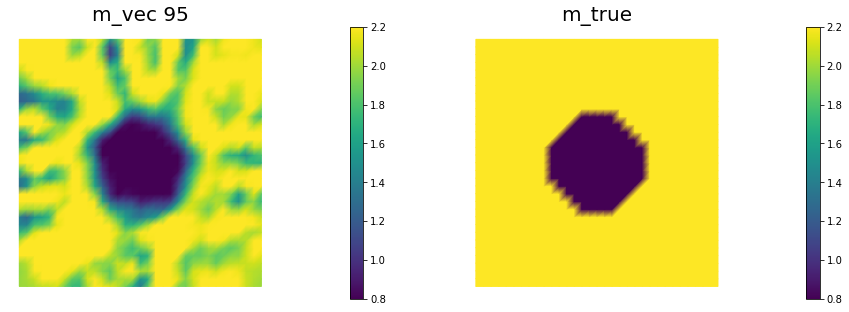

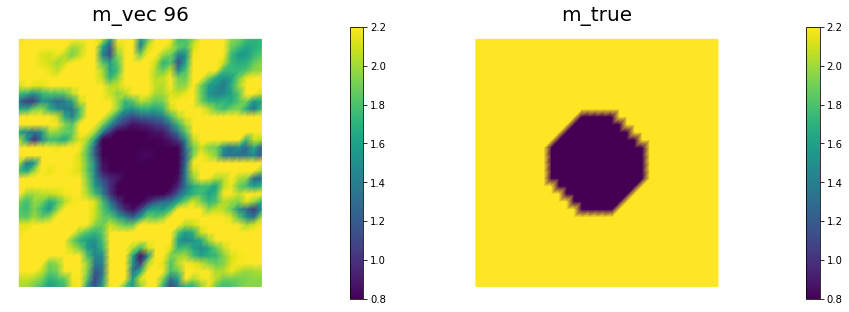

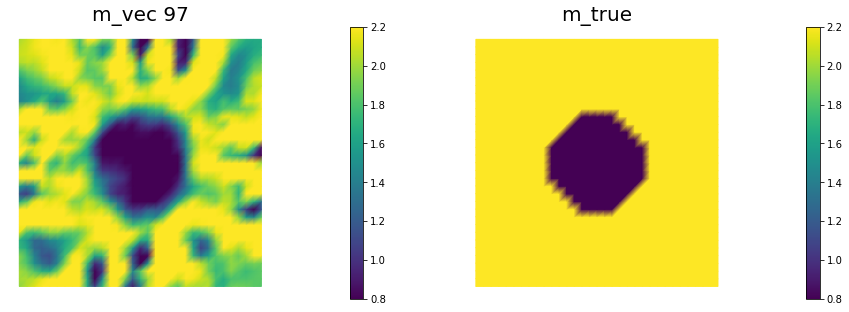

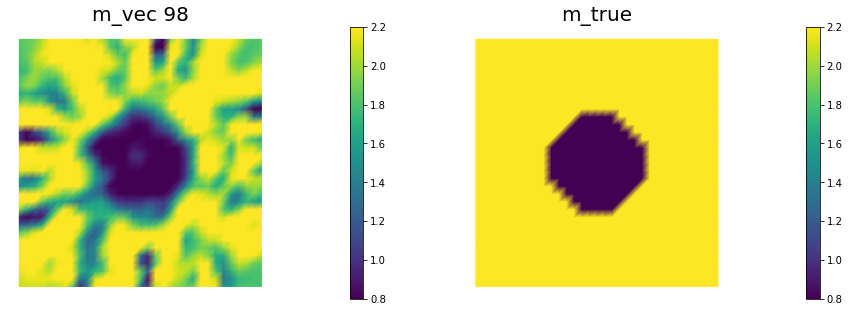

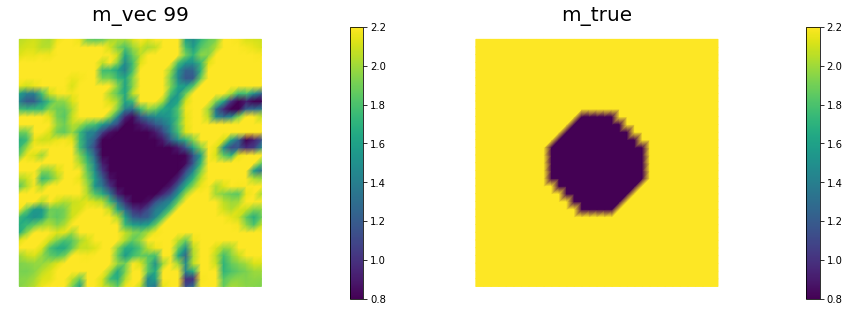

In [17]:
gamma = 1e-6

m_dim = []
Error = []
for r_dim in range(0,100):    
    # Active subspace
    W1 = (WW[:,:r_dim])
    W2 = (WW[:,r_dim:])

    Id = np.eye((nx+1)*(ny+1))

    # create mesh and define function spaces
    mesh = dl.UnitSquareMesh(nx, ny)
    Vm = dl.FunctionSpace(mesh, 'Lagrange', 1)
    Vu = dl.FunctionSpace(mesh, 'Lagrange', 2)

    # The true and inverted parameter
    mtrue_expression = dl.Expression('std::log(2 + 7*(std::pow(std::pow(x[0] - 0.5,2) + std::pow(x[1] - 0.5,2),0.5) > 0.2))', degree=5)
    
    mtrue = dl.interpolate(mtrue_expression,Vm)
    m = dl.interpolate(dl.Expression("std::log(2.0)", degree=1),Vm)

    # define function for state and adjoint
    u = dl.Function(Vu)
    p = dl.Function(Vu)

    # define Trial and Test Functions
    u_trial, p_trial, m_trial = dl.TrialFunction(Vu), dl.TrialFunction(Vu), dl.TrialFunction(Vm)
    u_test, p_test, m_test = dl.TestFunction(Vu), dl.TestFunction(Vu), dl.TestFunction(Vm)

    # initialize input functions
    f = dl.Constant(1.0)
    u0 = dl.Constant(0.0)


    # set up dirichlet boundary conditions
    def boundary(x,on_boundary):
        return on_boundary

    bc_state = dl.DirichletBC(Vu, u0, boundary)
    bc_adj = dl.DirichletBC(Vu, dl.Constant(0.), boundary)


    # noise level
    noise_level = 0.05

    # weak form for setting up the synthetic observations
    a_goal = ufl.inner(ufl.exp(mtrue) * ufl.grad(u_trial), ufl.grad(u_test)) * ufl.dx
    L_goal = f * u_test * ufl.dx

    # solve the forward/state problem to generate synthetic observations
    goal_A, goal_b = dl.assemble_system(a_goal, L_goal, bc_state)

    utrue = dl.Function(Vu)
    dl.solve(goal_A, utrue.vector(), goal_b)

    ud = dl.Function(Vu)
    ud.assign(utrue)

    # perturb state solution and create synthetic measurements ud
    # ud = u + ||u||/SNR * random.normal
    MAX = ud.vector().norm("linf")
    noise = dl.Vector()
    goal_A.init_vector(noise,1)
    parRandom.normal(noise_level * MAX, noise)
    bc_adj.apply(noise)

    ud.vector().axpy(1., noise)

    # regularization parameter
    # gamma = 5e-8

    # weak for for setting up the misfit and regularization compoment of the cost
    W_equ   = ufl.inner(u_trial, u_test) * ufl.dx
    R_equ   = gamma * (ufl.inner(ufl.grad(m_trial), ufl.grad(m_test)) * ufl.dx +\
             ufl.inner(m_trial, m_test) * ufl.dx)

    W = dl.assemble(W_equ)
    R = dl.assemble(R_equ)


    # Modifying the matrix R to consider active subspace

    M_prior = gamma * (ufl.inner(ufl.grad(m_trial), ufl.grad(m_test)) * ufl.dx +\
             ufl.inner(m_trial, m_test) * ufl.dx)
    M_Prior = dl.assemble(M_prior).array()
    UU, SSS, VVH = np.linalg.svd(M_Prior);
    M_Prior_half = UU @ np.diag(np.sqrt(SSS)) @ VVH
    M_sum = M_Prior_half @  (Id - W1 @ W1.T) @ M_Prior_half.T
    
    S = PETSc.Mat().create()
    S.setSizes(R.array().shape)
    S.setType("aij")
    S.setUp()
    S.setValues(range(0,R.array().shape[0]),range(0,R.array().shape[1]), M_sum)
    S.assemble()

    Rmat = dl.as_backend_type(R).mat()
    rmap, cmap = Rmat.getLGMap()
    S.setLGMap(rmap, cmap)

    R = dl.Matrix(dl.PETScMatrix(S))

    # refine cost function
    def cost(u, ud, m, W, R):
        diff = u.vector() - ud.vector()
        reg = 0.5 * m.vector().inner(R*m.vector()) 
        misfit = 0.5 * diff.inner(W * diff)
        return [reg + misfit, misfit, reg]

    # weak form for setting up the state equation
    a_state = ufl.inner(ufl.exp(m) * ufl.grad(u_trial), ufl.grad(u_test)) * ufl.dx
    L_state = f * u_test * ufl.dx

    # weak form for setting up the adjoint equation
    a_adj = ufl.inner(ufl.exp(m) * ufl.grad(p_trial), ufl.grad(p_test)) * ufl.dx
    L_adj = -ufl.inner(u - ud, p_test) * ufl.dx

    # weak form for setting up matrices
    Wum_equ = ufl.inner(ufl.exp(m) * m_trial * ufl.grad(p_test), ufl.grad(p)) * ufl.dx
    C_equ   = ufl.inner(ufl.exp(m) * m_trial * ufl.grad(u), ufl.grad(u_test)) * ufl.dx
    Wmm_equ = ufl.inner(ufl.exp(m) * m_trial * m_test *  ufl.grad(u),  ufl.grad(p)) * ufl.dx

    M_equ   = ufl.inner(m_trial, m_test) * ufl.dx

    # assemble matrix M
    M = dl.assemble(M_equ) 


    # solve state equation
    state_A, state_b = dl.assemble_system (a_state, L_state, bc_state)
    dl.solve (state_A, u.vector(), state_b)

    # evaluate cost
    [cost_old, misfit_old, reg_old] = cost(u, ud, m, W, R)

    # Class HessianOperator to perform Hessian apply to a vector
    class HessianOperator():
        cgiter = 0
        def __init__(self, R, Wmm, C, A, adj_A, W, Wum, gauss_newton_approx=False):
            self.R = R
            self.Wmm = Wmm
            self.C = C
            self.A = A
            self.adj_A = adj_A
            self.W = W
            self.Wum = Wum
            self.gauss_newton_approx = gauss_newton_approx

            # incremental state
            self.du = dl.Vector()
            self.A.init_vector(self.du,0)

            # incremental adjoint
            self.dp = dl.Vector()
            self.adj_A.init_vector(self.dp,0)

            # auxiliary vectors
            self.CT_dp = dl.Vector()
            self.C.init_vector(self.CT_dp, 1)
            self.Wum_du = dl.Vector()
            self.Wum.init_vector(self.Wum_du, 1)

        def init_vector(self, v, dim):
            self.R.init_vector(v,dim)

        # Hessian performed on v, output as generic vector y
        def mult(self, v, y):
            self.cgiter += 1
            y.zero()
            if self.gauss_newton_approx:
                self.mult_GaussNewton(v,y)
            else:
                self.mult_Newton(v,y)

        # define (Gauss-Newton) Hessian apply H * v
        def mult_GaussNewton(self, v, y):

            # incremental forward
            rhs = -(self.C * v)
            bc_adj.apply(rhs)
            dl.solve (self.A, self.du, rhs)

            # incremental adjoint
            rhs = - (self.W * self.du)
            bc_adj.apply(rhs)
            dl.solve (self.adj_A, self.dp, rhs)

            # Reg/Prior term
            self.R.mult(v,y)

            # Misfit term
            self.C.transpmult(self.dp, self.CT_dp)
            y.axpy(1, self.CT_dp)

        # define (Newton) Hessian apply H * v
        def mult_Newton(self, v, y):

            # incremental forward
            rhs = -(self.C * v)
            bc_adj.apply(rhs)
            dl.solve (self.A, self.du, rhs)

            # incremental adjoint
            rhs = -(self.W * self.du) -  self.Wum * v
            bc_adj.apply(rhs)
            dl.solve (self.adj_A, self.dp, rhs)

            # Reg/Prior term
            self.R.mult(v,y)
            y.axpy(1., self.Wmm*v)

            # Misfit term
            self.C.transpmult(self.dp, self.CT_dp)
            y.axpy(1., self.CT_dp)
            self.Wum.transpmult(self.du, self.Wum_du)
            y.axpy(1., self.Wum_du)


    # define parameters for the optimization
    tol = 1e-10
    c = 1e-5
    maxiter = 40
    plot_on = False

    # initialize iter counters
    iter = 1
    total_cg_iter = 0
    converged = False

    # initializations
    g, m_delta = dl.Vector(), dl.Vector()
    R.init_vector(m_delta,0)
    R.init_vector(g,0)

    m_prev = dl.Function(Vm)

    print ("Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg")

    while iter <  maxiter and not converged:

        # assemble matrix C
        C =  dl.assemble(C_equ)

        # solve the adoint problem
        adjoint_A, adjoint_RHS = dl.assemble_system(a_adj, L_adj, bc_adj)
        dl.solve(adjoint_A, p.vector(), adjoint_RHS)

        # assemble W_ua and R
        Wum = dl.assemble (Wum_equ)
        Wmm = dl.assemble (Wmm_equ)

        # evaluate the  gradient
        CT_p = dl.Vector()
        C.init_vector(CT_p,1)
        C.transpmult(p.vector(), CT_p)
        MG = CT_p + R * m.vector()

        #print(type(MG))
        #print(type(M))
        dl.solve(M, g, MG)

        # calculate the norm of the gradient
        grad2 = g.inner(MG)
        gradnorm = math.sqrt(grad2)

        # set the CG tolerance (use Eisenstat–Walker termination criterion)
        if iter == 1:
            gradnorm_ini = gradnorm
        tolcg = min(0.5, math.sqrt(gradnorm/gradnorm_ini))

        # define the Hessian apply operator (with preconditioner)
        Hess_Apply = HessianOperator(R, Wmm, C, state_A, adjoint_A, W, Wum, gauss_newton_approx=(iter<6) )
        P = R + gamma * M
        Psolver = dl.PETScKrylovSolver("cg", amg_method())
        Psolver.set_operator(P)

        solver = CGSolverSteihaug()
        solver.set_operator(Hess_Apply)
        solver.set_preconditioner(Psolver)
        solver.parameters["rel_tolerance"] = tolcg
        solver.parameters["zero_initial_guess"] = True
        solver.parameters["print_level"] = -1

        # solve the Newton system H a_delta = - MG
        solver.solve(m_delta, -MG)
        total_cg_iter += Hess_Apply.cgiter

        # linesearch
        alpha = 1
        descent = 0
        no_backtrack = 0
        m_prev.assign(m)
        while descent == 0 and no_backtrack < 10:
            m.vector().axpy(alpha, m_delta )

            # solve the state/forward problem
            state_A, state_b = dl.assemble_system(a_state, L_state, bc_state)
            dl.solve(state_A, u.vector(), state_b)

            # evaluate cost
            [cost_new, misfit_new, reg_new] = cost(u, ud, m, W, R)

            # check if Armijo conditions are satisfied
            if cost_new < cost_old + alpha * c * MG.inner(m_delta):
                cost_old = cost_new
                descent = 1
            else:
                no_backtrack += 1
                alpha *= 0.5
                m.assign(m_prev)  # reset a

        # calculate sqrt(-G * D)
        graddir = math.sqrt(- MG.inner(m_delta) )

        sp = ""
        print( "%2d %2s %2d %3s %8.5e %1s %8.5e %1s %8.5e %1s %8.5e %1s %8.5e %1s %5.2f %1s %5.3e" % \
            (iter, sp, Hess_Apply.cgiter, sp, cost_new, sp, misfit_new, sp, reg_new, sp, \
             graddir, sp, gradnorm, sp, alpha, sp, tolcg) )

        if plot_on:
            nb.multi1_plot([m,u,p], ["m","u","p"], same_colorbar=False)
            plt.show()

        # check for convergence
        if gradnorm < tol and iter > 1:
            converged = True
            print( "Newton's method converged in ",iter,"  iterations")
            print( "Total number of CG iterations: ", total_cg_iter)

        iter += 1

    if not converged:
        print( "Newton's method did not converge in ", maxiter, " iterations")
    m_dim.append(m.vector().get_local())
    
    Error.append(np.linalg.norm(mtrue.vector().get_local() - m.vector().get_local()) / np.linalg.norm(mtrue.vector().get_local()))

plt.plot(Error, color = 'r')
Error

m_dim = np.array(m_dim)

for r_dim in range(100):
    m_vec = dl.Function(Vm)
    m_vec_err = dl.Function(Vm)
    m_vec.vector().set_local(m_dim[r_dim,:])
    m_vec_err.vector().set_local(m_dim[r_dim,:]-mtrue.vector().get_local())
    # nb.multi1_plot([m_vec, mtrue,m_vec_err], ["m_vec", 'm_true','Error'],same_colorbar=False, vmin = 0.8, vmax = 2.2)
    nb.multi1_plot([m_vec, mtrue], ["m_vec %d" %(r_dim), 'm_true'],same_colorbar=False, vmin = 0.8, vmax = 2.2)

Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.13725e-05   1.12676e-05   1.04864e-07   1.56478e-02   3.79274e-04    1.00   5.000e-01
 2     1     9.64921e-07   7.78634e-07   1.86287e-07   4.66771e-03   5.32928e-05    1.00   3.749e-01
 3     1     5.18223e-07   2.99953e-07   2.18270e-07   9.50734e-04   6.96225e-06    1.00   1.355e-01
 4     3     4.85137e-07   2.42121e-07   2.43016e-07   2.49932e-04   9.05868e-07    1.00   4.887e-02
 5     6     4.84389e-07   2.37396e-07   2.46993e-07   3.73918e-05   1.55583e-07    1.00   2.025e-02
 6     5     4.84382e-07   2.36694e-07   2.47687e-07   3.85192e-06   1.06085e-08    1.00   5.289e-03
 7     9     4.84382e-07   2.36696e-07   2.47686e-07   3.27723e-08   1.67433e-10    1.00   6.644e-04
 8     4     4.84382e-07   2.36696e-07   2.47686e-07   1.14194e-11   5.08628e-14    1.00   1.158e-05
Newton's method converged in  8   iterations
Total number of CG iterations:  30
Nit   CGit   co

 5    12     2.02129e-07   1.94299e-07   7.83034e-09   2.98788e-05   1.49869e-07    1.00   1.988e-02
 6    14     2.02124e-07   1.94132e-07   7.99161e-09   3.18245e-06   1.59646e-08    1.00   6.490e-03
 7    21     2.02124e-07   1.94133e-07   7.99085e-09   2.86745e-08   1.38753e-10    1.00   6.050e-04
 8     9     2.02124e-07   1.94133e-07   7.99085e-09   4.75224e-12   2.01835e-14    0.00   7.297e-06
Newton's method converged in  8   iterations
Total number of CG iterations:  67
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.23623e-05   1.23591e-05   3.16035e-09   1.55991e-02   3.79328e-04    1.00   5.000e-01
 2     1     7.91621e-07   7.88834e-07   2.78649e-09   4.91962e-03   5.50632e-05    1.00   3.810e-01
 3     1     2.25925e-07   2.23269e-07   2.65611e-09   1.06692e-03   7.40406e-06    1.00   1.397e-01
 4     8     1.85407e-07   1.77649e-07   7.75836e-09   2.89091e-04   1.22512e-06    1.00   5.683e-02
 5    15     1.

Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.23954e-05   1.23930e-05   2.37869e-09   1.56093e-02   3.79530e-04    1.00   5.000e-01
 2     1     8.00297e-07   7.98084e-07   2.21281e-09   4.92454e-03   5.53151e-05    1.00   3.818e-01
 3     1     2.12399e-07   2.10244e-07   2.15477e-09   1.08760e-03   7.54156e-06    1.00   1.410e-01
 4     8     1.50232e-07   1.48533e-07   1.69905e-09   3.63666e-04   1.30748e-06    1.00   5.869e-02
 5    11     1.45970e-07   1.42839e-07   3.13121e-09   9.37398e-05   7.53754e-07    1.00   4.456e-02
 6    15     1.45811e-07   1.42582e-07   3.22831e-09   1.77127e-05   7.53387e-08    1.00   1.409e-02
 7    20     1.45810e-07   1.42578e-07   3.23247e-09   7.99794e-07   3.21792e-09    1.00   2.912e-03
 8    29     1.45810e-07   1.42578e-07   3.23235e-09   9.44104e-09   8.49050e-11    1.00   4.730e-04
Newton's method converged in  8   iterations
Total number of CG iterations:  86
Nit   CGit   co

 7    12     1.31982e-07   1.30836e-07   1.14565e-09   6.61658e-06   3.21901e-08    1.00   9.208e-03
 8    23     1.31982e-07   1.30832e-07   1.14943e-09   5.54635e-07   3.06383e-09    1.00   2.841e-03
 9    28     1.31982e-07   1.30832e-07   1.14940e-09   4.48495e-09   2.04535e-11    1.00   2.321e-04
Newton's method converged in  9   iterations
Total number of CG iterations:  96
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.21909e-05   1.21891e-05   1.83592e-09   1.56071e-02   3.79448e-04    1.00   5.000e-01
 2     1     7.70195e-07   7.68468e-07   1.72656e-09   4.88092e-03   5.50395e-05    1.00   3.809e-01
 3     1     2.25602e-07   2.23910e-07   1.69258e-09   1.04578e-03   7.33307e-06    1.00   1.390e-01
 4     9     1.44651e-07   1.43523e-07   1.12773e-09   4.39182e-04   1.20579e-06    1.00   5.637e-02
 5     4     1.31490e-07   1.30447e-07   1.04252e-09   1.62415e-04   9.85607e-07    1.00   5.097e-02
 6    16     1.

 4     9     1.32920e-07   1.32047e-07   8.73555e-10   4.48704e-04   1.16147e-06    1.00   5.532e-02
 5     9     1.27497e-07   1.27024e-07   4.72528e-10   1.08140e-04   6.63155e-07    1.00   4.180e-02
 6    13     1.27087e-07   1.26634e-07   4.52492e-10   2.83547e-05   1.94004e-07    1.00   2.261e-02
 7    26     1.27082e-07   1.26627e-07   4.55745e-10   2.94397e-06   1.62961e-08    1.00   6.552e-03
 8    25     1.27082e-07   1.26627e-07   4.55736e-10   5.37627e-08   2.63888e-10    1.00   8.338e-04
 9    30     1.27082e-07   1.26627e-07   4.55736e-10   1.72722e-10   8.06499e-13    1.00   4.609e-05
Newton's method converged in  9   iterations
Total number of CG iterations:  115
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.22389e-05   1.22372e-05   1.76680e-09   1.56140e-02   3.79746e-04    1.00   5.000e-01
 2     1     7.67494e-07   7.65800e-07   1.69402e-09   4.89185e-03   5.51773e-05    1.00   3.812e-01
 3     1     2

 9    39     1.14456e-07   1.14359e-07   9.71447e-11   1.36968e-08   4.76113e-11    1.00   3.537e-04
Newton's method converged in  9   iterations
Total number of CG iterations:  108
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.24279e-05   1.24262e-05   1.67098e-09   1.55977e-02   3.79586e-04    1.00   5.000e-01
 2     1     7.85379e-07   7.83766e-07   1.61325e-09   4.92878e-03   5.57191e-05    1.00   3.831e-01
 3     1     2.28427e-07   2.26834e-07   1.59271e-09   1.05794e-03   7.37880e-06    1.00   1.394e-01
 4    12     1.14754e-07   1.14403e-07   3.50925e-10   4.88113e-04   1.16953e-06    1.00   5.551e-02
 5    12     1.10374e-07   1.10246e-07   1.27400e-10   1.03708e-04   4.92644e-07    1.00   3.603e-02
 6     7     1.09416e-07   1.09295e-07   1.21396e-10   4.40289e-05   2.44808e-07    1.00   2.540e-02
 7    22     1.09397e-07   1.09279e-07   1.17677e-10   6.24458e-06   5.40477e-08    1.00   1.193e-02
 8    26     1

Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.24648e-05   1.24632e-05   1.60404e-09   1.55947e-02   3.79568e-04    1.00   5.000e-01
 2     1     7.90272e-07   7.88719e-07   1.55337e-09   4.93580e-03   5.57904e-05    1.00   3.834e-01
 3     1     2.30572e-07   2.29038e-07   1.53439e-09   1.06075e-03   7.38210e-06    1.00   1.395e-01
 4    10     1.11205e-07   1.10856e-07   3.49023e-10   4.96970e-04   1.16462e-06    1.00   5.539e-02
 5    15     1.07817e-07   1.07773e-07   4.33336e-11   1.04864e-04   4.47012e-07    1.00   3.432e-02
 6     3     1.05775e-07   1.05731e-07   4.32540e-11   6.45262e-05   3.44990e-07    1.00   3.015e-02
 7    31     1.05721e-07   1.05681e-07   4.00017e-11   1.14034e-05   2.19983e-08    1.00   7.613e-03
 8    16     1.05715e-07   1.05675e-07   4.00691e-11   3.41509e-06   1.73121e-08    1.00   6.754e-03
 9    39     1.05715e-07   1.05675e-07   4.01297e-11   3.03854e-07   3.57149e-10    1.00   9.70

 9    34     1.04855e-07   1.04821e-07   3.38409e-11   1.21578e-06   9.35106e-10    1.00   1.569e-03
10    23     1.04855e-07   1.04821e-07   3.38423e-11   7.81649e-08   4.01145e-10    1.00   1.028e-03
11    40     1.04855e-07   1.04821e-07   3.38424e-11   5.08214e-10   1.06963e-12    1.00   5.307e-05
Newton's method converged in  11   iterations
Total number of CG iterations:  175
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.25155e-05   1.25139e-05   1.55782e-09   1.55933e-02   3.79637e-04    1.00   5.000e-01
 2     1     7.90660e-07   7.89142e-07   1.51777e-09   4.94660e-03   5.59899e-05    1.00   3.840e-01
 3     1     2.29006e-07   2.27504e-07   1.50267e-09   1.06244e-03   7.39630e-06    1.00   1.396e-01
 4     9     1.13567e-07   1.13163e-07   4.04384e-10   4.91358e-04   1.14621e-06    1.00   5.495e-02
 5    13     1.10581e-07   1.10540e-07   4.15096e-11   1.11038e-04   5.41250e-07    1.00   3.776e-02
 6     4     

 1     1     1.25582e-05   1.25568e-05   1.40660e-09   1.55930e-02   3.79665e-04    1.00   5.000e-01
 2     1     7.95106e-07   7.93733e-07   1.37341e-09   4.95541e-03   5.61147e-05    1.00   3.844e-01
 3     1     2.31548e-07   2.30188e-07   1.36056e-09   1.06440e-03   7.39996e-06    1.00   1.396e-01
 4    10     1.14596e-07   1.14270e-07   3.25961e-10   4.91717e-04   1.12595e-06    1.00   5.446e-02
 5    15     1.12213e-07   1.12182e-07   3.16013e-11   9.75424e-05   4.27553e-07    1.00   3.356e-02
 6     3     1.10030e-07   1.09998e-07   3.15087e-11   6.68484e-05   3.55203e-07    1.00   3.059e-02
 7    37     1.09956e-07   1.09927e-07   2.92810e-11   1.41236e-05   2.32613e-08    1.00   7.827e-03
 8    15     1.09941e-07   1.09912e-07   2.91906e-11   5.43984e-06   2.70983e-08    1.00   8.448e-03
 9    42     1.09940e-07   1.09911e-07   2.91563e-11   9.27569e-07   7.56424e-10    1.00   1.412e-03
10    29     1.09940e-07   1.09911e-07   2.91555e-11   5.06525e-08   2.54419e-10    1.00   

 7    42     1.05009e-07   1.04983e-07   2.60956e-11   1.58079e-05   3.23188e-08    1.00   9.226e-03
 8    14     1.04974e-07   1.04947e-07   2.60479e-11   8.26626e-06   4.27257e-08    1.00   1.061e-02
 9    49     1.04972e-07   1.04946e-07   2.61270e-11   1.74972e-06   1.16422e-09    1.00   1.751e-03
10    29     1.04972e-07   1.04946e-07   2.61271e-11   1.78201e-07   9.60444e-10    1.00   1.590e-03
11    61     1.04972e-07   1.04946e-07   2.61270e-11   1.88251e-09   1.92416e-12    1.00   7.119e-05
Newton's method converged in  11   iterations
Total number of CG iterations:  226
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.26138e-05   1.26125e-05   1.32175e-09   1.56001e-02   3.79857e-04    1.00   5.000e-01
 2     1     8.05327e-07   8.04031e-07   1.29516e-09   4.96511e-03   5.62051e-05    1.00   3.847e-01
 3     1     2.34598e-07   2.33313e-07   1.28443e-09   1.07106e-03   7.43141e-06    1.00   1.399e-01
 4     9     

11    57     1.10110e-07   1.10083e-07   2.71258e-11   5.57803e-09   9.82094e-12    1.00   1.608e-04
Newton's method converged in  11   iterations
Total number of CG iterations:  236
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.26113e-05   1.26100e-05   1.27502e-09   1.55993e-02   3.79857e-04    1.00   5.000e-01
 2     1     8.05007e-07   8.03756e-07   1.25166e-09   4.96503e-03   5.62121e-05    1.00   3.847e-01
 3     1     2.35378e-07   2.34136e-07   1.24174e-09   1.07008e-03   7.42683e-06    1.00   1.398e-01
 4    10     1.15006e-07   1.14774e-07   2.31862e-10   4.97970e-04   1.13691e-06    1.00   5.471e-02
 5    19     1.12103e-07   1.12043e-07   5.96204e-11   9.85559e-05   3.88434e-07    0.50   3.198e-02
 6    12     1.10500e-07   1.10469e-07   3.08248e-11   5.70933e-05   2.68718e-07    1.00   2.660e-02
 7    47     1.10496e-07   1.10468e-07   2.80759e-11   2.88957e-05   5.94348e-08    1.00   1.251e-02
 8     3     

13    61     1.09274e-07   1.09253e-07   2.06690e-11   1.51405e-09   6.02303e-12    1.00   1.260e-04
Newton's method converged in  13   iterations
Total number of CG iterations:  326
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.26049e-05   1.26036e-05   1.25154e-09   1.55888e-02   3.79601e-04    1.00   5.000e-01
 2     1     8.00865e-07   7.99635e-07   1.22946e-09   4.96443e-03   5.62228e-05    1.00   3.849e-01
 3     1     2.31260e-07   2.30040e-07   1.21994e-09   1.07018e-03   7.42727e-06    1.00   1.399e-01
 4    10     1.11107e-07   1.10835e-07   2.71922e-10   4.95104e-04   1.14488e-06    1.00   5.492e-02
 5    29     1.08817e-07   1.08736e-07   8.10942e-11   8.95851e-05   3.69467e-07    0.50   3.120e-02
 6    14     1.07400e-07   1.07379e-07   2.10438e-11   5.32055e-05   2.67090e-07    1.00   2.653e-02
 7    49     1.07197e-07   1.07179e-07   1.83161e-11   2.50130e-05   3.31916e-08    0.50   9.351e-03
 8    19     

12    69     1.10847e-07   1.10826e-07   2.04704e-11   5.35574e-08   4.96484e-11    1.00   3.619e-04
Newton's method converged in  12   iterations
Total number of CG iterations:  333
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.26077e-05   1.26065e-05   1.20589e-09   1.55814e-02   3.79441e-04    1.00   5.000e-01
 2     1     8.10563e-07   8.09377e-07   1.18608e-09   4.96245e-03   5.62170e-05    1.00   3.849e-01
 3     1     2.41437e-07   2.40260e-07   1.17690e-09   1.06962e-03   7.42932e-06    1.00   1.399e-01
 4    10     1.13578e-07   1.13364e-07   2.13629e-10   5.12970e-04   1.15460e-06    1.00   5.516e-02
 5    26     1.10194e-07   1.10138e-07   5.61765e-11   1.04678e-04   3.65877e-07    0.50   3.105e-02
 6    14     1.08479e-07   1.08457e-07   2.11606e-11   5.90419e-05   2.61184e-07    1.00   2.624e-02
 7    54     1.08229e-07   1.08210e-07   1.89553e-11   3.03567e-05   3.90622e-08    0.50   1.015e-02
 8    15     

 7    18     1.08551e-07   1.08533e-07   1.83233e-11   5.09791e-04   9.86785e-08    0.00   1.613e-02
 8    20     1.08140e-07   1.08127e-07   1.34051e-11   2.94951e-05   8.84046e-08    1.00   1.526e-02
 9    51     1.08122e-07   1.08108e-07   1.31303e-11   8.32540e-06   1.18987e-08    1.00   5.600e-03
10    14     1.08110e-07   1.08097e-07   1.31265e-11   4.73385e-06   2.58166e-08    1.00   8.249e-03
11    66     1.08110e-07   1.08097e-07   1.31436e-11   8.16099e-07   4.24110e-10    1.00   1.057e-03
12    35     1.08110e-07   1.08097e-07   1.31437e-11   5.42506e-08   3.06202e-10    1.00   8.984e-04
13    65     1.08110e-07   1.08097e-07   1.31436e-11   3.27525e-10   3.75473e-13    1.00   3.146e-05
Newton's method converged in  13   iterations
Total number of CG iterations:  317
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.26189e-05   1.26177e-05   1.19271e-09   1.55869e-02   3.79577e-04    1.00   5.000e-01
 2     1     

 1     1     1.26855e-05   1.26843e-05   1.18507e-09   1.56085e-02   3.80106e-04    1.00   5.000e-01
 2     1     8.08061e-07   8.06895e-07   1.16572e-09   4.98021e-03   5.63619e-05    1.00   3.851e-01
 3     1     2.31977e-07   2.30820e-07   1.15659e-09   1.07618e-03   7.45433e-06    1.00   1.400e-01
 4    12     1.13013e-07   1.12880e-07   1.33378e-10   4.99606e-04   1.14087e-06    1.00   5.479e-02
 5    15     1.08625e-07   1.08607e-07   1.77572e-11   1.13941e-04   4.58072e-07    1.00   3.471e-02
 6     8     1.06494e-07   1.06480e-07   1.37350e-11   6.67162e-05   3.55051e-07    1.00   3.056e-02
 7    92     1.06378e-07   1.06365e-07   1.28317e-11   2.90193e-05   3.84442e-08    0.25   1.006e-02
 8    21     1.06278e-07   1.06266e-07   1.16401e-11   1.34215e-05   5.56406e-08    1.00   1.210e-02
 9    38     1.06263e-07   1.06252e-07   1.16875e-11   5.26590e-06   7.72052e-09    1.00   4.507e-03
10    25     1.06261e-07   1.06250e-07   1.16999e-11   2.01503e-06   9.98471e-09    1.00   

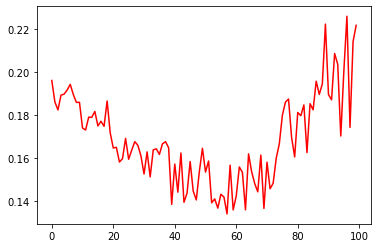

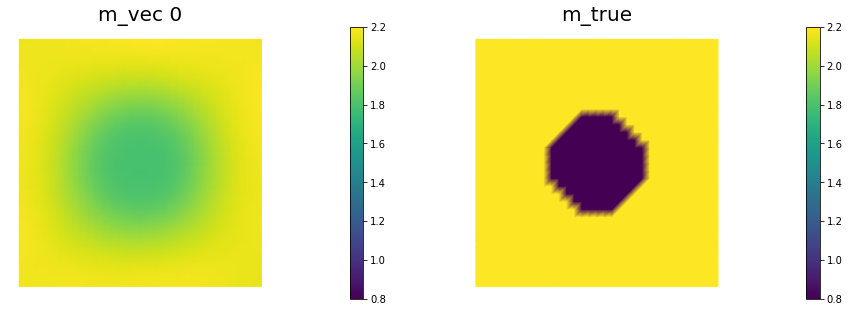

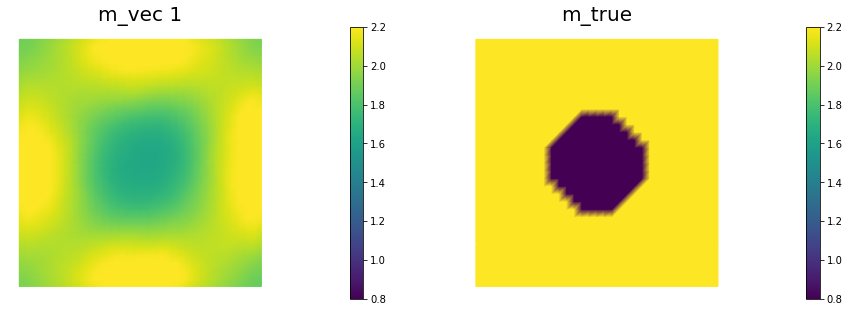

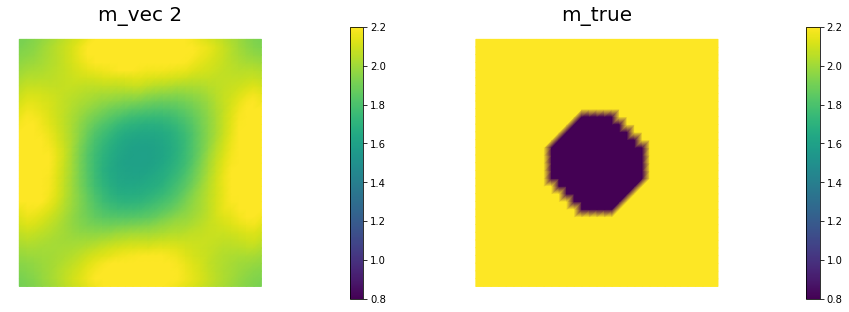

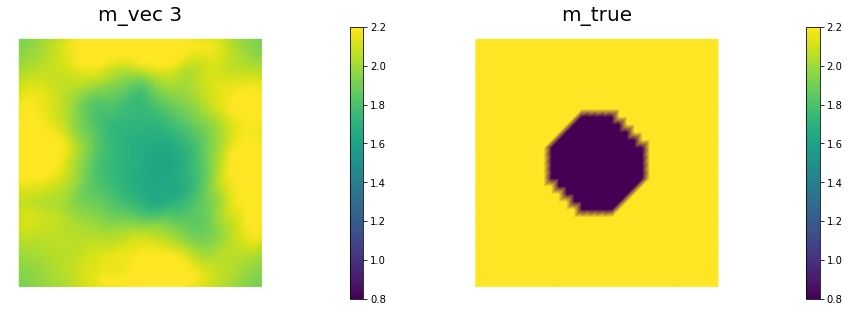

...

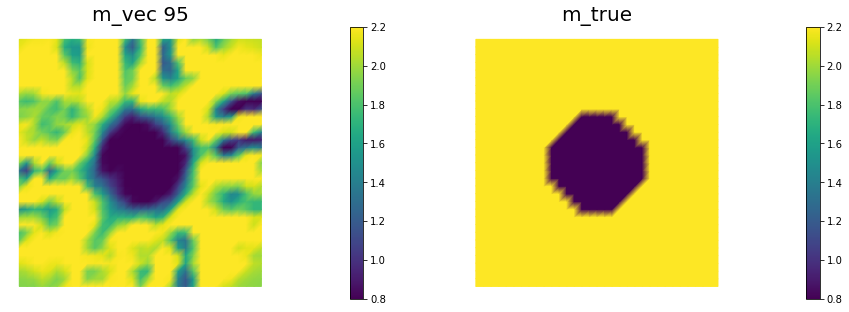

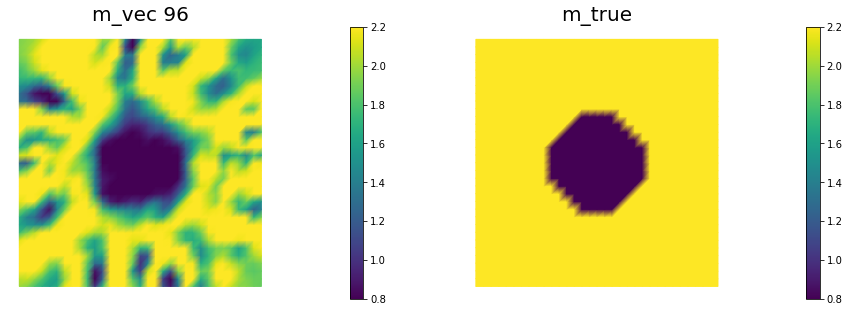

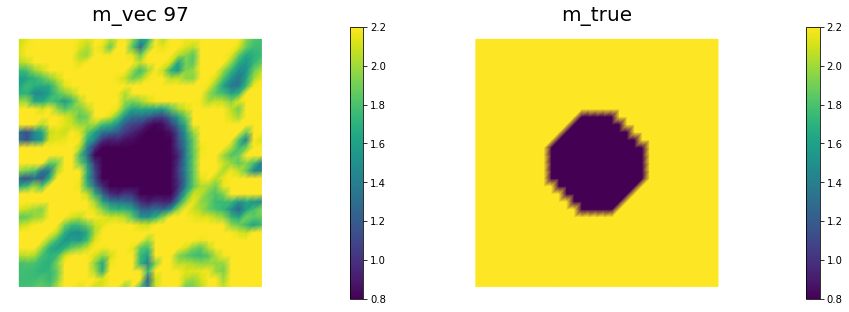

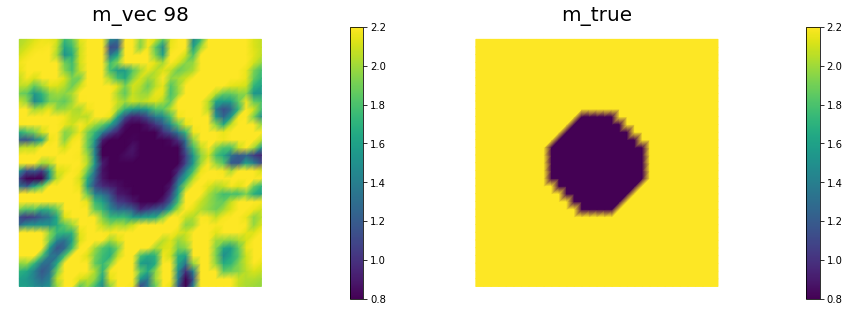

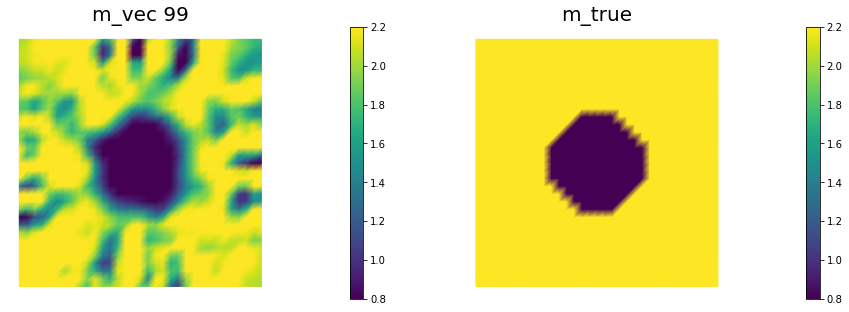

In [18]:
gamma = 1e-7

m_dim = []
Error = []
for r_dim in range(0,100):    
    # Active subspace
    W1 = (WW[:,:r_dim])
    W2 = (WW[:,r_dim:])

    Id = np.eye((nx+1)*(ny+1))

    # create mesh and define function spaces
    mesh = dl.UnitSquareMesh(nx, ny)
    Vm = dl.FunctionSpace(mesh, 'Lagrange', 1)
    Vu = dl.FunctionSpace(mesh, 'Lagrange', 2)

    # The true and inverted parameter
    mtrue_expression = dl.Expression('std::log(2 + 7*(std::pow(std::pow(x[0] - 0.5,2) + std::pow(x[1] - 0.5,2),0.5) > 0.2))', degree=5)
    
    mtrue = dl.interpolate(mtrue_expression,Vm)
    m = dl.interpolate(dl.Expression("std::log(2.0)", degree=1),Vm)

    # define function for state and adjoint
    u = dl.Function(Vu)
    p = dl.Function(Vu)

    # define Trial and Test Functions
    u_trial, p_trial, m_trial = dl.TrialFunction(Vu), dl.TrialFunction(Vu), dl.TrialFunction(Vm)
    u_test, p_test, m_test = dl.TestFunction(Vu), dl.TestFunction(Vu), dl.TestFunction(Vm)

    # initialize input functions
    f = dl.Constant(1.0)
    u0 = dl.Constant(0.0)


    # set up dirichlet boundary conditions
    def boundary(x,on_boundary):
        return on_boundary

    bc_state = dl.DirichletBC(Vu, u0, boundary)
    bc_adj = dl.DirichletBC(Vu, dl.Constant(0.), boundary)


    # noise level
    noise_level = 0.05

    # weak form for setting up the synthetic observations
    a_goal = ufl.inner(ufl.exp(mtrue) * ufl.grad(u_trial), ufl.grad(u_test)) * ufl.dx
    L_goal = f * u_test * ufl.dx

    # solve the forward/state problem to generate synthetic observations
    goal_A, goal_b = dl.assemble_system(a_goal, L_goal, bc_state)

    utrue = dl.Function(Vu)
    dl.solve(goal_A, utrue.vector(), goal_b)

    ud = dl.Function(Vu)
    ud.assign(utrue)

    # perturb state solution and create synthetic measurements ud
    # ud = u + ||u||/SNR * random.normal
    MAX = ud.vector().norm("linf")
    noise = dl.Vector()
    goal_A.init_vector(noise,1)
    parRandom.normal(noise_level * MAX, noise)
    bc_adj.apply(noise)

    ud.vector().axpy(1., noise)

    # regularization parameter
    # gamma = 5e-8

    # weak for for setting up the misfit and regularization compoment of the cost
    W_equ   = ufl.inner(u_trial, u_test) * ufl.dx
    R_equ   = gamma * (ufl.inner(ufl.grad(m_trial), ufl.grad(m_test)) * ufl.dx +\
             ufl.inner(m_trial, m_test) * ufl.dx)

    W = dl.assemble(W_equ)
    R = dl.assemble(R_equ)


    # Modifying the matrix R to consider active subspace

    M_prior = gamma * (ufl.inner(ufl.grad(m_trial), ufl.grad(m_test)) * ufl.dx +\
             ufl.inner(m_trial, m_test) * ufl.dx)
    M_Prior = dl.assemble(M_prior).array()
    UU, SSS, VVH = np.linalg.svd(M_Prior);
    M_Prior_half = UU @ np.diag(np.sqrt(SSS)) @ VVH
    M_sum = M_Prior_half @  (Id - W1 @ W1.T) @ M_Prior_half.T
    
    S = PETSc.Mat().create()
    S.setSizes(R.array().shape)
    S.setType("aij")
    S.setUp()
    S.setValues(range(0,R.array().shape[0]),range(0,R.array().shape[1]), M_sum)
    S.assemble()

    Rmat = dl.as_backend_type(R).mat()
    rmap, cmap = Rmat.getLGMap()
    S.setLGMap(rmap, cmap)

    R = dl.Matrix(dl.PETScMatrix(S))

    # refine cost function
    def cost(u, ud, m, W, R):
        diff = u.vector() - ud.vector()
        reg = 0.5 * m.vector().inner(R*m.vector()) 
        misfit = 0.5 * diff.inner(W * diff)
        return [reg + misfit, misfit, reg]

    # weak form for setting up the state equation
    a_state = ufl.inner(ufl.exp(m) * ufl.grad(u_trial), ufl.grad(u_test)) * ufl.dx
    L_state = f * u_test * ufl.dx

    # weak form for setting up the adjoint equation
    a_adj = ufl.inner(ufl.exp(m) * ufl.grad(p_trial), ufl.grad(p_test)) * ufl.dx
    L_adj = -ufl.inner(u - ud, p_test) * ufl.dx

    # weak form for setting up matrices
    Wum_equ = ufl.inner(ufl.exp(m) * m_trial * ufl.grad(p_test), ufl.grad(p)) * ufl.dx
    C_equ   = ufl.inner(ufl.exp(m) * m_trial * ufl.grad(u), ufl.grad(u_test)) * ufl.dx
    Wmm_equ = ufl.inner(ufl.exp(m) * m_trial * m_test *  ufl.grad(u),  ufl.grad(p)) * ufl.dx

    M_equ   = ufl.inner(m_trial, m_test) * ufl.dx

    # assemble matrix M
    M = dl.assemble(M_equ) 


    # solve state equation
    state_A, state_b = dl.assemble_system (a_state, L_state, bc_state)
    dl.solve (state_A, u.vector(), state_b)

    # evaluate cost
    [cost_old, misfit_old, reg_old] = cost(u, ud, m, W, R)

    # Class HessianOperator to perform Hessian apply to a vector
    class HessianOperator():
        cgiter = 0
        def __init__(self, R, Wmm, C, A, adj_A, W, Wum, gauss_newton_approx=False):
            self.R = R
            self.Wmm = Wmm
            self.C = C
            self.A = A
            self.adj_A = adj_A
            self.W = W
            self.Wum = Wum
            self.gauss_newton_approx = gauss_newton_approx

            # incremental state
            self.du = dl.Vector()
            self.A.init_vector(self.du,0)

            # incremental adjoint
            self.dp = dl.Vector()
            self.adj_A.init_vector(self.dp,0)

            # auxiliary vectors
            self.CT_dp = dl.Vector()
            self.C.init_vector(self.CT_dp, 1)
            self.Wum_du = dl.Vector()
            self.Wum.init_vector(self.Wum_du, 1)

        def init_vector(self, v, dim):
            self.R.init_vector(v,dim)

        # Hessian performed on v, output as generic vector y
        def mult(self, v, y):
            self.cgiter += 1
            y.zero()
            if self.gauss_newton_approx:
                self.mult_GaussNewton(v,y)
            else:
                self.mult_Newton(v,y)

        # define (Gauss-Newton) Hessian apply H * v
        def mult_GaussNewton(self, v, y):

            # incremental forward
            rhs = -(self.C * v)
            bc_adj.apply(rhs)
            dl.solve (self.A, self.du, rhs)

            # incremental adjoint
            rhs = - (self.W * self.du)
            bc_adj.apply(rhs)
            dl.solve (self.adj_A, self.dp, rhs)

            # Reg/Prior term
            self.R.mult(v,y)

            # Misfit term
            self.C.transpmult(self.dp, self.CT_dp)
            y.axpy(1, self.CT_dp)

        # define (Newton) Hessian apply H * v
        def mult_Newton(self, v, y):

            # incremental forward
            rhs = -(self.C * v)
            bc_adj.apply(rhs)
            dl.solve (self.A, self.du, rhs)

            # incremental adjoint
            rhs = -(self.W * self.du) -  self.Wum * v
            bc_adj.apply(rhs)
            dl.solve (self.adj_A, self.dp, rhs)

            # Reg/Prior term
            self.R.mult(v,y)
            y.axpy(1., self.Wmm*v)

            # Misfit term
            self.C.transpmult(self.dp, self.CT_dp)
            y.axpy(1., self.CT_dp)
            self.Wum.transpmult(self.du, self.Wum_du)
            y.axpy(1., self.Wum_du)


    # define parameters for the optimization
    tol = 1e-10
    c = 1e-5
    maxiter = 40
    plot_on = False

    # initialize iter counters
    iter = 1
    total_cg_iter = 0
    converged = False

    # initializations
    g, m_delta = dl.Vector(), dl.Vector()
    R.init_vector(m_delta,0)
    R.init_vector(g,0)

    m_prev = dl.Function(Vm)

    print ("Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg")

    while iter <  maxiter and not converged:

        # assemble matrix C
        C =  dl.assemble(C_equ)

        # solve the adoint problem
        adjoint_A, adjoint_RHS = dl.assemble_system(a_adj, L_adj, bc_adj)
        dl.solve(adjoint_A, p.vector(), adjoint_RHS)

        # assemble W_ua and R
        Wum = dl.assemble (Wum_equ)
        Wmm = dl.assemble (Wmm_equ)

        # evaluate the  gradient
        CT_p = dl.Vector()
        C.init_vector(CT_p,1)
        C.transpmult(p.vector(), CT_p)
        MG = CT_p + R * m.vector()

        #print(type(MG))
        #print(type(M))
        dl.solve(M, g, MG)

        # calculate the norm of the gradient
        grad2 = g.inner(MG)
        gradnorm = math.sqrt(grad2)

        # set the CG tolerance (use Eisenstat–Walker termination criterion)
        if iter == 1:
            gradnorm_ini = gradnorm
        tolcg = min(0.5, math.sqrt(gradnorm/gradnorm_ini))

        # define the Hessian apply operator (with preconditioner)
        Hess_Apply = HessianOperator(R, Wmm, C, state_A, adjoint_A, W, Wum, gauss_newton_approx=(iter<6) )
        P = R + gamma * M
        Psolver = dl.PETScKrylovSolver("cg", amg_method())
        Psolver.set_operator(P)

        solver = CGSolverSteihaug()
        solver.set_operator(Hess_Apply)
        solver.set_preconditioner(Psolver)
        solver.parameters["rel_tolerance"] = tolcg
        solver.parameters["zero_initial_guess"] = True
        solver.parameters["print_level"] = -1

        # solve the Newton system H a_delta = - MG
        solver.solve(m_delta, -MG)
        total_cg_iter += Hess_Apply.cgiter

        # linesearch
        alpha = 1
        descent = 0
        no_backtrack = 0
        m_prev.assign(m)
        while descent == 0 and no_backtrack < 10:
            m.vector().axpy(alpha, m_delta )

            # solve the state/forward problem
            state_A, state_b = dl.assemble_system(a_state, L_state, bc_state)
            dl.solve(state_A, u.vector(), state_b)

            # evaluate cost
            [cost_new, misfit_new, reg_new] = cost(u, ud, m, W, R)

            # check if Armijo conditions are satisfied
            if cost_new < cost_old + alpha * c * MG.inner(m_delta):
                cost_old = cost_new
                descent = 1
            else:
                no_backtrack += 1
                alpha *= 0.5
                m.assign(m_prev)  # reset a

        # calculate sqrt(-G * D)
        graddir = math.sqrt(- MG.inner(m_delta) )

        sp = ""
        print( "%2d %2s %2d %3s %8.5e %1s %8.5e %1s %8.5e %1s %8.5e %1s %8.5e %1s %5.2f %1s %5.3e" % \
            (iter, sp, Hess_Apply.cgiter, sp, cost_new, sp, misfit_new, sp, reg_new, sp, \
             graddir, sp, gradnorm, sp, alpha, sp, tolcg) )

        if plot_on:
            nb.multi1_plot([m,u,p], ["m","u","p"], same_colorbar=False)
            plt.show()

        # check for convergence
        if gradnorm < tol and iter > 1:
            converged = True
            print( "Newton's method converged in ",iter,"  iterations")
            print( "Total number of CG iterations: ", total_cg_iter)

        iter += 1

    if not converged:
        print( "Newton's method did not converge in ", maxiter, " iterations")
    m_dim.append(m.vector().get_local())
    
    Error.append(np.linalg.norm(mtrue.vector().get_local() - m.vector().get_local()) / np.linalg.norm(mtrue.vector().get_local()))

plt.plot(Error, color = 'r')
Error

m_dim = np.array(m_dim)

for r_dim in range(100):
    m_vec = dl.Function(Vm)
    m_vec_err = dl.Function(Vm)
    m_vec.vector().set_local(m_dim[r_dim,:])
    m_vec_err.vector().set_local(m_dim[r_dim,:]-mtrue.vector().get_local())
    # nb.multi1_plot([m_vec, mtrue,m_vec_err], ["m_vec", 'm_true','Error'],same_colorbar=False, vmin = 0.8, vmax = 2.2)
    nb.multi1_plot([m_vec, mtrue], ["m_vec %d" %(r_dim), 'm_true'],same_colorbar=False, vmin = 0.8, vmax = 2.2)

Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.12746e-05   1.12641e-05   1.04975e-08   1.56621e-02   3.79572e-04    1.00   5.000e-01
 2     1     7.74357e-07   7.55666e-07   1.86909e-08   4.68557e-03   5.34354e-05    1.00   3.752e-01
 3     1     3.05790e-07   2.83808e-07   2.19824e-08   9.71425e-04   7.09505e-06    1.00   1.367e-01
 4     5     1.98720e-07   1.50314e-07   4.84064e-08   4.32856e-04   9.71070e-07    1.00   5.058e-02
 5     5     1.89954e-07   1.35131e-07   5.48229e-08   1.31752e-04   5.43914e-07    1.00   3.785e-02
 6    10     1.89272e-07   1.30577e-07   5.86953e-08   3.72779e-05   8.30694e-08    1.00   1.479e-02
 7    12     1.89270e-07   1.30856e-07   5.84133e-08   2.16725e-06   5.42043e-09    1.00   3.779e-03
 8    19     1.89270e-07   1.30855e-07   5.84146e-08   4.58219e-08   1.18271e-10    1.00   5.582e-04
 9    10     1.89270e-07   1.30855e-07   5.84146e-08   8.66080e-12   2.80137e-14    0.03   8.59

 1     1     1.25037e-05   1.25034e-05   3.15495e-10   1.56224e-02   3.79965e-04    1.00   5.000e-01
 2     1     8.14937e-07   8.14662e-07   2.74752e-10   4.94580e-03   5.52610e-05    1.00   3.814e-01
 3     1     2.38740e-07   2.38479e-07   2.61218e-10   1.07699e-03   7.39447e-06    1.00   1.395e-01
 4    10     1.67744e-07   1.54857e-07   1.28866e-08   3.79490e-04   9.33411e-07    1.00   4.956e-02
 5    16     1.56030e-07   1.33342e-07   2.26878e-08   1.52684e-04   3.50679e-07    1.00   3.038e-02
 6    24     1.55415e-07   1.29912e-07   2.55029e-08   3.54323e-05   7.70798e-08    1.00   1.424e-02
 7    31     1.55412e-07   1.30152e-07   2.52601e-08   2.30274e-06   5.66531e-09    1.00   3.861e-03
 8    47     1.55412e-07   1.30151e-07   2.52607e-08   3.70463e-08   1.12104e-10    1.00   5.432e-04
 9    31     1.55412e-07   1.30151e-07   2.52607e-08   2.23130e-11   5.81833e-14    1.00   1.237e-05
Newton's method converged in  9   iterations
Total number of CG iterations:  162
Nit   CGit

 4    14     1.43631e-07   1.36227e-07   7.40452e-09   4.16109e-04   1.00147e-06    1.00   5.137e-02
 5    23     1.38504e-07   1.27258e-07   1.12466e-08   1.05446e-04   2.62842e-07    1.00   2.632e-02
 6    14     1.38130e-07   1.26992e-07   1.11382e-08   2.73564e-05   1.28827e-07    1.00   1.842e-02
 7    38     1.38116e-07   1.26822e-07   1.12938e-08   5.29401e-06   1.50168e-08    1.00   6.290e-03
 8    48     1.38116e-07   1.26823e-07   1.12928e-08   2.92879e-08   8.77787e-11    1.00   4.809e-04
Newton's method converged in  8   iterations
Total number of CG iterations:  140
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.24495e-05   1.24492e-05   2.37923e-10   1.56218e-02   3.79785e-04    1.00   5.000e-01
 2     1     8.11265e-07   8.11044e-07   2.21638e-10   4.93398e-03   5.53571e-05    1.00   3.818e-01
 3     1     2.16608e-07   2.16391e-07   2.16706e-10   1.09391e-03   7.50566e-06    1.00   1.406e-01
 4     8     1

 2     1     7.59117e-07   7.58945e-07   1.72746e-10   4.88811e-03   5.50629e-05    1.00   3.808e-01
 3     1     2.11833e-07   2.11663e-07   1.70021e-10   1.04844e-03   7.28446e-06    1.00   1.385e-01
 4    10     1.32166e-07   1.31895e-07   2.70523e-10   4.20975e-04   8.72816e-07    1.00   4.794e-02
 5    15     1.20410e-07   1.17388e-07   3.02194e-09   1.53555e-04   6.69501e-07    1.00   4.199e-02
 6    33     1.19631e-07   1.15468e-07   4.16389e-09   3.91245e-05   1.06823e-07    1.00   1.677e-02
 7    38     1.19626e-07   1.15497e-07   4.12881e-09   3.23912e-06   9.60514e-09    1.00   5.029e-03
 8    54     1.19626e-07   1.15495e-07   4.13154e-09   1.31642e-07   4.78415e-10    1.00   1.122e-03
 9    65     1.19626e-07   1.15495e-07   4.13153e-09   5.48057e-10   1.44414e-12    1.00   6.167e-05
Newton's method converged in  9   iterations
Total number of CG iterations:  218
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1

 8    44     1.18477e-07   1.15827e-07   2.65043e-09   1.78752e-07   7.97932e-10    1.00   1.450e-03
 9    77     1.18477e-07   1.15827e-07   2.65040e-09   1.92857e-09   5.24783e-12    1.00   1.176e-04
Newton's method converged in  9   iterations
Total number of CG iterations:  219
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.22395e-05   1.22393e-05   1.77156e-10   1.56105e-02   3.79646e-04    1.00   5.000e-01
 2     1     7.71101e-07   7.70931e-07   1.70074e-10   4.89136e-03   5.51636e-05    1.00   3.812e-01
 3     1     2.25166e-07   2.24997e-07   1.68471e-10   1.04722e-03   7.27000e-06    1.00   1.384e-01
 4     9     1.32681e-07   1.32481e-07   2.00503e-10   4.53886e-04   8.51929e-07    1.00   4.737e-02
 5     9     1.24255e-07   1.23968e-07   2.87315e-10   1.33335e-04   6.38868e-07    1.00   4.102e-02
 6    19     1.21391e-07   1.18442e-07   2.94917e-09   7.59989e-05   2.21638e-07    1.00   2.416e-02
 7    49     1

Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.24699e-05   1.24698e-05   1.68932e-10   1.56145e-02   3.79968e-04    1.00   5.000e-01
 2     1     7.86004e-07   7.85841e-07   1.63319e-10   4.93822e-03   5.57640e-05    1.00   3.831e-01
 3     1     2.24839e-07   2.24677e-07   1.61857e-10   1.06198e-03   7.34229e-06    1.00   1.390e-01
 4    10     1.18312e-07   1.18139e-07   1.73348e-10   4.71401e-04   8.37976e-07    1.00   4.696e-02
 5    13     1.15293e-07   1.15089e-07   2.04333e-10   9.60659e-05   3.48974e-07    1.00   3.031e-02
 6     7     1.13743e-07   1.13525e-07   2.17636e-10   5.59394e-05   3.17459e-07    1.00   2.890e-02
 7    53     1.13107e-07   1.12086e-07   1.02071e-09   3.57438e-05   1.13756e-07    1.00   1.730e-02
 8    30     1.13106e-07   1.12088e-07   1.01834e-09   1.35702e-06   6.95017e-09    1.00   4.277e-03
 9    70     1.13106e-07   1.12088e-07   1.01824e-09   3.12011e-08   5.03334e-11    1.00   3.64

 4    10     1.16022e-07   1.15875e-07   1.46984e-10   4.78866e-04   8.25795e-07    1.00   4.666e-02
 5    22     1.15150e-07   1.15004e-07   1.46432e-10   9.65172e-05   2.68889e-07    1.00   2.662e-02
 6     2     1.11490e-07   1.11343e-07   1.46840e-10   8.65729e-05   4.83433e-07    1.00   3.570e-02
 7    42     1.11232e-07   1.10821e-07   4.11360e-10   2.29021e-05   8.25844e-08    1.00   1.475e-02
 8    36     1.11230e-07   1.10819e-07   4.11022e-10   2.16192e-06   9.35313e-09    1.00   4.965e-03
 9    72     1.11230e-07   1.10818e-07   4.11366e-10   1.24699e-07   2.73423e-10    1.00   8.490e-04
10    74     1.11230e-07   1.10818e-07   4.11366e-10   5.84861e-10   2.16876e-12    1.00   7.561e-05
Newton's method converged in  10   iterations
Total number of CG iterations:  261
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.24460e-05   1.24458e-05   1.60461e-10   1.55943e-02   3.79545e-04    1.00   5.000e-01
 2     1     

 2     1     7.93405e-07   7.93252e-07   1.52581e-10   4.94780e-03   5.59913e-05    1.00   3.841e-01
 3     1     2.30745e-07   2.30594e-07   1.51629e-10   1.06346e-03   7.35787e-06    1.00   1.392e-01
 4    11     1.11029e-07   1.10888e-07   1.41195e-10   4.98366e-04   8.43195e-07    1.00   4.713e-02
 5    15     1.09345e-07   1.09218e-07   1.27256e-10   9.61947e-05   2.94957e-07    1.00   2.788e-02
 6     3     1.06427e-07   1.06300e-07   1.27350e-10   7.72730e-05   4.21183e-07    1.00   3.331e-02
 7    50     1.06112e-07   1.05761e-07   3.51154e-10   2.55746e-05   1.01145e-07    1.00   1.632e-02
 8    24     1.06106e-07   1.05755e-07   3.50706e-10   3.28880e-06   1.49832e-08    1.00   6.283e-03
 9    70     1.06106e-07   1.05755e-07   3.50495e-10   5.20821e-07   1.37189e-09    1.00   1.901e-03
10    54     1.06106e-07   1.05755e-07   3.50500e-10   1.01150e-08   4.50880e-11    1.00   3.446e-04
Newton's method converged in  10   iterations
Total number of CG iterations:  230
Nit   CGi

10    51     1.16046e-07   1.15708e-07   3.37861e-10   4.84888e-08   2.32907e-10    1.00   7.832e-04
11    83     1.16046e-07   1.15708e-07   3.37861e-10   2.83722e-10   4.68485e-13    1.00   3.513e-05
Newton's method converged in  11   iterations
Total number of CG iterations:  315
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.25642e-05   1.25640e-05   1.40701e-10   1.55885e-02   3.79543e-04    1.00   5.000e-01
 2     1     8.03485e-07   8.03347e-07   1.37569e-10   4.95455e-03   5.61072e-05    1.00   3.845e-01
 3     1     2.38798e-07   2.38661e-07   1.36785e-10   1.06542e-03   7.36939e-06    1.00   1.393e-01
 4    10     1.17829e-07   1.17698e-07   1.30615e-10   5.00432e-04   8.41209e-07    1.00   4.708e-02
 5    19     1.15015e-07   1.14897e-07   1.18888e-10   1.01842e-04   2.82809e-07    0.50   2.730e-02
 6     8     1.12957e-07   1.12839e-07   1.17611e-10   6.33455e-05   2.98438e-07    1.00   2.804e-02
 7    53     

Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.25597e-05   1.25595e-05   1.32209e-10   1.55845e-02   3.79469e-04    1.00   5.000e-01
 2     1     7.99076e-07   7.98947e-07   1.29723e-10   4.95466e-03   5.61249e-05    1.00   3.846e-01
 3     1     2.34626e-07   2.34497e-07   1.29137e-10   1.06519e-03   7.36807e-06    1.00   1.393e-01
 4    12     1.15807e-07   1.15683e-07   1.24759e-10   4.99285e-04   8.33359e-07    1.00   4.686e-02
 5    16     1.13118e-07   1.13000e-07   1.18172e-10   1.16737e-04   3.73458e-07    1.00   3.137e-02
 6     3     1.09145e-07   1.09027e-07   1.18163e-10   9.04393e-05   4.98632e-07    1.00   3.625e-02
 7    62     1.08950e-07   1.08793e-07   1.56949e-10   2.92448e-05   9.76074e-08    0.50   1.604e-02
 8    30     1.08802e-07   1.08511e-07   2.90887e-10   1.69793e-05   7.80629e-08    1.00   1.434e-02
 9    67     1.08796e-07   1.08504e-07   2.91585e-10   3.61592e-06   2.61790e-09    1.00   2.62

 5    41     1.12118e-07   1.12040e-07   7.82537e-11   9.63985e-05   1.75717e-07    0.50   2.152e-02
 6     9     1.10467e-07   1.10387e-07   8.00607e-11   5.78939e-05   2.40518e-07    1.00   2.517e-02
 7    60     1.10327e-07   1.10166e-07   1.60579e-10   2.97505e-05   6.10865e-08    1.00   1.269e-02
 8     3     1.10058e-07   1.09898e-07   1.60580e-10   2.32449e-05   1.31591e-07    1.00   1.862e-02
 9    68     1.10052e-07   1.09890e-07   1.61725e-10   3.72121e-06   2.72093e-09    1.00   2.677e-03
10    18     1.10051e-07   1.09890e-07   1.61723e-10   6.64128e-07   3.43107e-09    1.00   3.006e-03
11    104     1.10051e-07   1.09890e-07   1.61712e-10   2.21922e-08   4.13742e-11    1.00   3.301e-04
Newton's method converged in  11   iterations
Total number of CG iterations:  316
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.26391e-05   1.26390e-05   1.27546e-10   1.56088e-02   3.80073e-04    1.00   5.000e-01
 2     1    

 9    49     1.08963e-07   1.08767e-07   1.95253e-10   5.69690e-06   1.50623e-08    1.00   6.296e-03
10    52     1.08962e-07   1.08767e-07   1.94989e-10   1.22584e-06   4.49624e-09    1.00   3.440e-03
11    67     1.08962e-07   1.08767e-07   1.94962e-10   1.03045e-07   2.58507e-10    1.00   8.249e-04
12    84     1.08962e-07   1.08767e-07   1.94962e-10   9.68474e-10   3.51294e-12    1.00   9.616e-05
Newton's method converged in  12   iterations
Total number of CG iterations:  391
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.26336e-05   1.26334e-05   1.25186e-10   1.55999e-02   3.79867e-04    1.00   5.000e-01
 2     1     8.06765e-07   8.06642e-07   1.23145e-10   4.96919e-03   5.62451e-05    1.00   3.848e-01
 3     1     2.34033e-07   2.33910e-07   1.22648e-10   1.07298e-03   7.40020e-06    1.00   1.396e-01
 4    12     1.14233e-07   1.14121e-07   1.12203e-10   4.99441e-04   8.35321e-07    1.00   4.689e-02
 5    20     

 8    12     1.07040e-07   1.06921e-07   1.19402e-10   2.62399e-05   1.42995e-07    1.00   1.940e-02
 9    69     1.07008e-07   1.06829e-07   1.78973e-10   8.22927e-06   2.55110e-08    1.00   8.193e-03
10     9     1.07006e-07   1.06827e-07   1.78968e-10   1.65858e-06   9.52912e-09    1.00   5.007e-03
11    103     1.07006e-07   1.06827e-07   1.78876e-10   9.24368e-08   1.45196e-10    1.00   6.181e-04
12    77     1.07006e-07   1.06827e-07   1.78876e-10   3.07840e-10   1.73510e-12    1.00   6.757e-05
Newton's method converged in  12   iterations
Total number of CG iterations:  413
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.25869e-05   1.25868e-05   1.20629e-10   1.55740e-02   3.79252e-04    1.00   5.000e-01
 2     1     8.09225e-07   8.09107e-07   1.18823e-10   4.95812e-03   5.61788e-05    1.00   3.849e-01
 3     1     2.42139e-07   2.42021e-07   1.18365e-10   1.06767e-03   7.38185e-06    1.00   1.395e-01
 4    10    

Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.27046e-05   1.27045e-05   1.19337e-10   1.56137e-02   3.80218e-04    1.00   5.000e-01
 2     1     8.18119e-07   8.18001e-07   1.17549e-10   4.98226e-03   5.63490e-05    1.00   3.850e-01
 3     1     2.39211e-07   2.39094e-07   1.17097e-10   1.07888e-03   7.42257e-06    1.00   1.397e-01
 4    12     1.12705e-07   1.12602e-07   1.03132e-10   5.12540e-04   8.45891e-07    1.00   4.717e-02
 5    24     1.09056e-07   1.08974e-07   8.19468e-11   1.14571e-04   2.98053e-07    0.50   2.800e-02
 6     9     1.06609e-07   1.06530e-07   7.86762e-11   7.31985e-05   3.20477e-07    1.00   2.903e-02
 7    28     1.27851e-07   1.27778e-07   7.35419e-11   7.96031e-04   8.68001e-08    0.00   1.511e-02
 8     6     1.06609e-07   1.06530e-07   7.86585e-11   3.17630e-04   1.01940e-06    0.00   5.178e-02
 9    19     1.06364e-07   1.06292e-07   7.19025e-11   1.88462e-04   9.08106e-08    0.02   1.54

Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.26407e-05   1.26406e-05   1.18545e-10   1.55910e-02   3.79670e-04    1.00   5.000e-01
 2     1     8.03681e-07   8.03564e-07   1.16774e-10   4.97123e-03   5.62963e-05    1.00   3.851e-01
 3     1     2.31418e-07   2.31302e-07   1.16294e-10   1.07265e-03   7.40124e-06    1.00   1.396e-01
 4    12     1.05913e-07   1.05812e-07   1.01114e-10   5.08286e-04   8.38977e-07    1.00   4.701e-02
 5    28     1.03297e-07   1.03228e-07   6.92194e-11   1.03346e-04   1.97818e-07    0.50   2.283e-02
 6     9     1.01085e-07   1.01019e-07   6.57667e-11   7.05356e-05   2.83374e-07    1.00   2.732e-02
 7    20     1.01077e-07   1.01023e-07   5.41280e-11   1.31749e-04   8.22113e-08    0.03   1.472e-02
 8    14     1.00572e-07   1.00520e-07   5.23171e-11   3.32316e-05   1.58610e-07    1.00   2.044e-02
 9    57     1.00505e-07   1.00423e-07   8.19921e-11   1.35312e-05   4.94691e-08    1.00   1.14

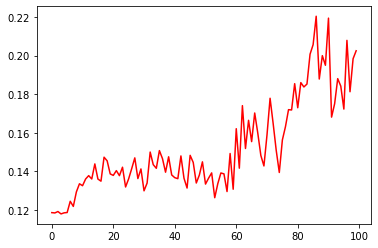

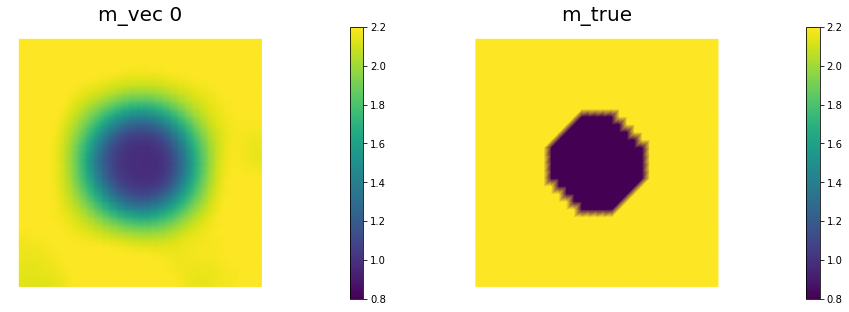

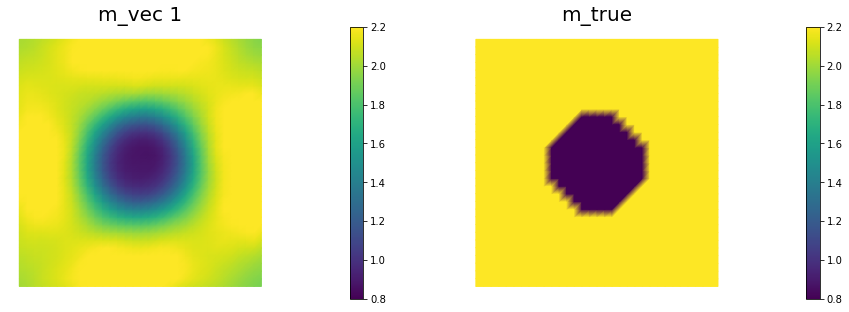

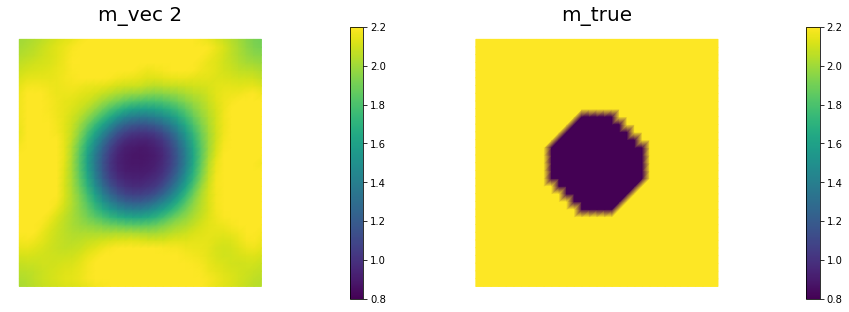

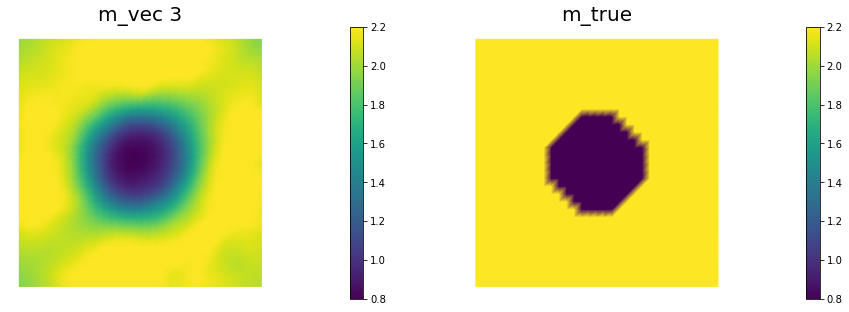

...

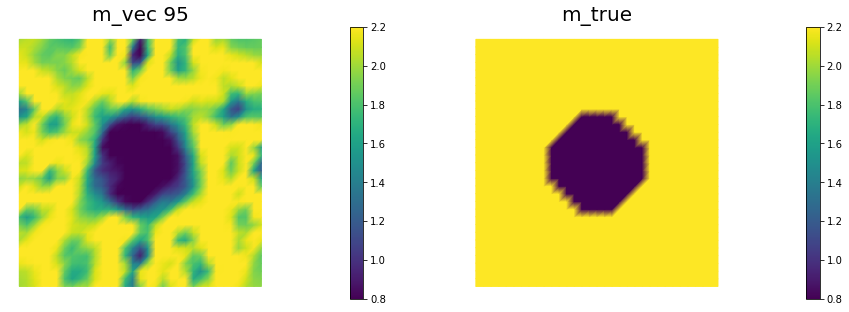

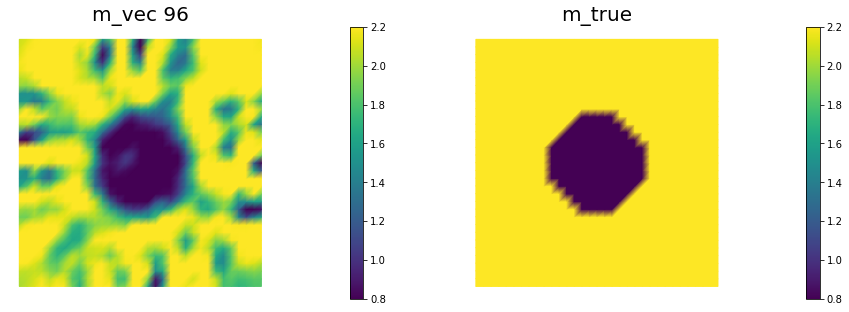

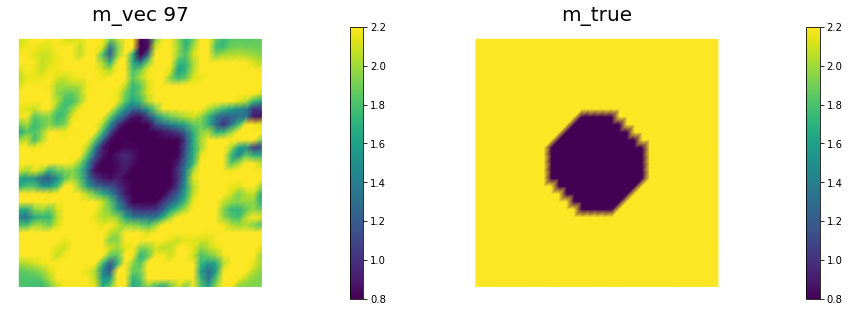

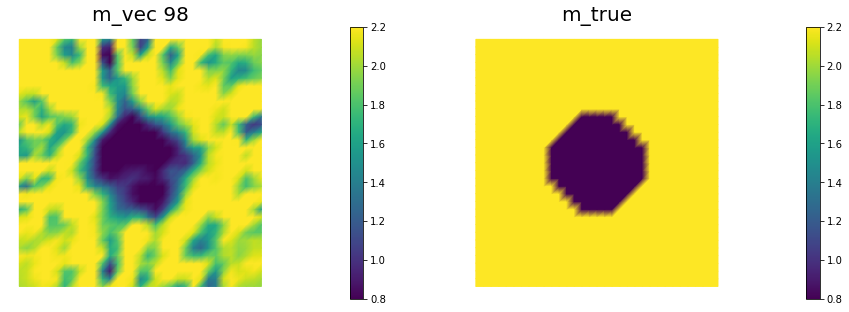

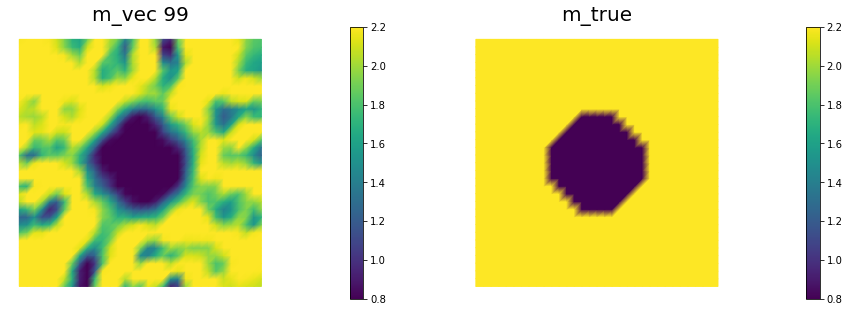

In [19]:
gamma = 1e-8

m_dim = []
Error = []
for r_dim in range(0,100):    
    # Active subspace
    W1 = (WW[:,:r_dim])
    W2 = (WW[:,r_dim:])

    Id = np.eye((nx+1)*(ny+1))

    # create mesh and define function spaces
    mesh = dl.UnitSquareMesh(nx, ny)
    Vm = dl.FunctionSpace(mesh, 'Lagrange', 1)
    Vu = dl.FunctionSpace(mesh, 'Lagrange', 2)

    # The true and inverted parameter
    mtrue_expression = dl.Expression('std::log(2 + 7*(std::pow(std::pow(x[0] - 0.5,2) + std::pow(x[1] - 0.5,2),0.5) > 0.2))', degree=5)
    
    mtrue = dl.interpolate(mtrue_expression,Vm)
    m = dl.interpolate(dl.Expression("std::log(2.0)", degree=1),Vm)

    # define function for state and adjoint
    u = dl.Function(Vu)
    p = dl.Function(Vu)

    # define Trial and Test Functions
    u_trial, p_trial, m_trial = dl.TrialFunction(Vu), dl.TrialFunction(Vu), dl.TrialFunction(Vm)
    u_test, p_test, m_test = dl.TestFunction(Vu), dl.TestFunction(Vu), dl.TestFunction(Vm)

    # initialize input functions
    f = dl.Constant(1.0)
    u0 = dl.Constant(0.0)


    # set up dirichlet boundary conditions
    def boundary(x,on_boundary):
        return on_boundary

    bc_state = dl.DirichletBC(Vu, u0, boundary)
    bc_adj = dl.DirichletBC(Vu, dl.Constant(0.), boundary)


    # noise level
    noise_level = 0.05

    # weak form for setting up the synthetic observations
    a_goal = ufl.inner(ufl.exp(mtrue) * ufl.grad(u_trial), ufl.grad(u_test)) * ufl.dx
    L_goal = f * u_test * ufl.dx

    # solve the forward/state problem to generate synthetic observations
    goal_A, goal_b = dl.assemble_system(a_goal, L_goal, bc_state)

    utrue = dl.Function(Vu)
    dl.solve(goal_A, utrue.vector(), goal_b)

    ud = dl.Function(Vu)
    ud.assign(utrue)

    # perturb state solution and create synthetic measurements ud
    # ud = u + ||u||/SNR * random.normal
    MAX = ud.vector().norm("linf")
    noise = dl.Vector()
    goal_A.init_vector(noise,1)
    parRandom.normal(noise_level * MAX, noise)
    bc_adj.apply(noise)

    ud.vector().axpy(1., noise)

    # regularization parameter
    # gamma = 5e-8

    # weak for for setting up the misfit and regularization compoment of the cost
    W_equ   = ufl.inner(u_trial, u_test) * ufl.dx
    R_equ   = gamma * (ufl.inner(ufl.grad(m_trial), ufl.grad(m_test)) * ufl.dx +\
             ufl.inner(m_trial, m_test) * ufl.dx)

    W = dl.assemble(W_equ)
    R = dl.assemble(R_equ)


    # Modifying the matrix R to consider active subspace

    M_prior = gamma * (ufl.inner(ufl.grad(m_trial), ufl.grad(m_test)) * ufl.dx +\
             ufl.inner(m_trial, m_test) * ufl.dx)
    M_Prior = dl.assemble(M_prior).array()
    UU, SSS, VVH = np.linalg.svd(M_Prior);
    M_Prior_half = UU @ np.diag(np.sqrt(SSS)) @ VVH
    M_sum = M_Prior_half @  (Id - W1 @ W1.T) @ M_Prior_half.T
    
    S = PETSc.Mat().create()
    S.setSizes(R.array().shape)
    S.setType("aij")
    S.setUp()
    S.setValues(range(0,R.array().shape[0]),range(0,R.array().shape[1]), M_sum)
    S.assemble()

    Rmat = dl.as_backend_type(R).mat()
    rmap, cmap = Rmat.getLGMap()
    S.setLGMap(rmap, cmap)

    R = dl.Matrix(dl.PETScMatrix(S))

    # refine cost function
    def cost(u, ud, m, W, R):
        diff = u.vector() - ud.vector()
        reg = 0.5 * m.vector().inner(R*m.vector()) 
        misfit = 0.5 * diff.inner(W * diff)
        return [reg + misfit, misfit, reg]

    # weak form for setting up the state equation
    a_state = ufl.inner(ufl.exp(m) * ufl.grad(u_trial), ufl.grad(u_test)) * ufl.dx
    L_state = f * u_test * ufl.dx

    # weak form for setting up the adjoint equation
    a_adj = ufl.inner(ufl.exp(m) * ufl.grad(p_trial), ufl.grad(p_test)) * ufl.dx
    L_adj = -ufl.inner(u - ud, p_test) * ufl.dx

    # weak form for setting up matrices
    Wum_equ = ufl.inner(ufl.exp(m) * m_trial * ufl.grad(p_test), ufl.grad(p)) * ufl.dx
    C_equ   = ufl.inner(ufl.exp(m) * m_trial * ufl.grad(u), ufl.grad(u_test)) * ufl.dx
    Wmm_equ = ufl.inner(ufl.exp(m) * m_trial * m_test *  ufl.grad(u),  ufl.grad(p)) * ufl.dx

    M_equ   = ufl.inner(m_trial, m_test) * ufl.dx

    # assemble matrix M
    M = dl.assemble(M_equ) 


    # solve state equation
    state_A, state_b = dl.assemble_system (a_state, L_state, bc_state)
    dl.solve (state_A, u.vector(), state_b)

    # evaluate cost
    [cost_old, misfit_old, reg_old] = cost(u, ud, m, W, R)

    # Class HessianOperator to perform Hessian apply to a vector
    class HessianOperator():
        cgiter = 0
        def __init__(self, R, Wmm, C, A, adj_A, W, Wum, gauss_newton_approx=False):
            self.R = R
            self.Wmm = Wmm
            self.C = C
            self.A = A
            self.adj_A = adj_A
            self.W = W
            self.Wum = Wum
            self.gauss_newton_approx = gauss_newton_approx

            # incremental state
            self.du = dl.Vector()
            self.A.init_vector(self.du,0)

            # incremental adjoint
            self.dp = dl.Vector()
            self.adj_A.init_vector(self.dp,0)

            # auxiliary vectors
            self.CT_dp = dl.Vector()
            self.C.init_vector(self.CT_dp, 1)
            self.Wum_du = dl.Vector()
            self.Wum.init_vector(self.Wum_du, 1)

        def init_vector(self, v, dim):
            self.R.init_vector(v,dim)

        # Hessian performed on v, output as generic vector y
        def mult(self, v, y):
            self.cgiter += 1
            y.zero()
            if self.gauss_newton_approx:
                self.mult_GaussNewton(v,y)
            else:
                self.mult_Newton(v,y)

        # define (Gauss-Newton) Hessian apply H * v
        def mult_GaussNewton(self, v, y):

            # incremental forward
            rhs = -(self.C * v)
            bc_adj.apply(rhs)
            dl.solve (self.A, self.du, rhs)

            # incremental adjoint
            rhs = - (self.W * self.du)
            bc_adj.apply(rhs)
            dl.solve (self.adj_A, self.dp, rhs)

            # Reg/Prior term
            self.R.mult(v,y)

            # Misfit term
            self.C.transpmult(self.dp, self.CT_dp)
            y.axpy(1, self.CT_dp)

        # define (Newton) Hessian apply H * v
        def mult_Newton(self, v, y):

            # incremental forward
            rhs = -(self.C * v)
            bc_adj.apply(rhs)
            dl.solve (self.A, self.du, rhs)

            # incremental adjoint
            rhs = -(self.W * self.du) -  self.Wum * v
            bc_adj.apply(rhs)
            dl.solve (self.adj_A, self.dp, rhs)

            # Reg/Prior term
            self.R.mult(v,y)
            y.axpy(1., self.Wmm*v)

            # Misfit term
            self.C.transpmult(self.dp, self.CT_dp)
            y.axpy(1., self.CT_dp)
            self.Wum.transpmult(self.du, self.Wum_du)
            y.axpy(1., self.Wum_du)


    # define parameters for the optimization
    tol = 1e-10
    c = 1e-5
    maxiter = 40
    plot_on = False

    # initialize iter counters
    iter = 1
    total_cg_iter = 0
    converged = False

    # initializations
    g, m_delta = dl.Vector(), dl.Vector()
    R.init_vector(m_delta,0)
    R.init_vector(g,0)

    m_prev = dl.Function(Vm)

    print ("Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg")

    while iter <  maxiter and not converged:

        # assemble matrix C
        C =  dl.assemble(C_equ)

        # solve the adoint problem
        adjoint_A, adjoint_RHS = dl.assemble_system(a_adj, L_adj, bc_adj)
        dl.solve(adjoint_A, p.vector(), adjoint_RHS)

        # assemble W_ua and R
        Wum = dl.assemble (Wum_equ)
        Wmm = dl.assemble (Wmm_equ)

        # evaluate the  gradient
        CT_p = dl.Vector()
        C.init_vector(CT_p,1)
        C.transpmult(p.vector(), CT_p)
        MG = CT_p + R * m.vector()

        #print(type(MG))
        #print(type(M))
        dl.solve(M, g, MG)

        # calculate the norm of the gradient
        grad2 = g.inner(MG)
        gradnorm = math.sqrt(grad2)

        # set the CG tolerance (use Eisenstat–Walker termination criterion)
        if iter == 1:
            gradnorm_ini = gradnorm
        tolcg = min(0.5, math.sqrt(gradnorm/gradnorm_ini))

        # define the Hessian apply operator (with preconditioner)
        Hess_Apply = HessianOperator(R, Wmm, C, state_A, adjoint_A, W, Wum, gauss_newton_approx=(iter<6) )
        P = R + gamma * M
        Psolver = dl.PETScKrylovSolver("cg", amg_method())
        Psolver.set_operator(P)

        solver = CGSolverSteihaug()
        solver.set_operator(Hess_Apply)
        solver.set_preconditioner(Psolver)
        solver.parameters["rel_tolerance"] = tolcg
        solver.parameters["zero_initial_guess"] = True
        solver.parameters["print_level"] = -1

        # solve the Newton system H a_delta = - MG
        solver.solve(m_delta, -MG)
        total_cg_iter += Hess_Apply.cgiter

        # linesearch
        alpha = 1
        descent = 0
        no_backtrack = 0
        m_prev.assign(m)
        while descent == 0 and no_backtrack < 10:
            m.vector().axpy(alpha, m_delta )

            # solve the state/forward problem
            state_A, state_b = dl.assemble_system(a_state, L_state, bc_state)
            dl.solve(state_A, u.vector(), state_b)

            # evaluate cost
            [cost_new, misfit_new, reg_new] = cost(u, ud, m, W, R)

            # check if Armijo conditions are satisfied
            if cost_new < cost_old + alpha * c * MG.inner(m_delta):
                cost_old = cost_new
                descent = 1
            else:
                no_backtrack += 1
                alpha *= 0.5
                m.assign(m_prev)  # reset a

        # calculate sqrt(-G * D)
        graddir = math.sqrt(- MG.inner(m_delta) )

        sp = ""
        print( "%2d %2s %2d %3s %8.5e %1s %8.5e %1s %8.5e %1s %8.5e %1s %8.5e %1s %5.2f %1s %5.3e" % \
            (iter, sp, Hess_Apply.cgiter, sp, cost_new, sp, misfit_new, sp, reg_new, sp, \
             graddir, sp, gradnorm, sp, alpha, sp, tolcg) )

        if plot_on:
            nb.multi1_plot([m,u,p], ["m","u","p"], same_colorbar=False)
            plt.show()

        # check for convergence
        if gradnorm < tol and iter > 1:
            converged = True
            print( "Newton's method converged in ",iter,"  iterations")
            print( "Total number of CG iterations: ", total_cg_iter)

        iter += 1

    if not converged:
        print( "Newton's method did not converge in ", maxiter, " iterations")
    m_dim.append(m.vector().get_local())
    
    Error.append(np.linalg.norm(mtrue.vector().get_local() - m.vector().get_local()) / np.linalg.norm(mtrue.vector().get_local()))

plt.plot(Error, color = 'r')
Error

m_dim = np.array(m_dim)

for r_dim in range(100):
    m_vec = dl.Function(Vm)
    m_vec_err = dl.Function(Vm)
    m_vec.vector().set_local(m_dim[r_dim,:])
    m_vec_err.vector().set_local(m_dim[r_dim,:]-mtrue.vector().get_local())
    # nb.multi1_plot([m_vec, mtrue,m_vec_err], ["m_vec", 'm_true','Error'],same_colorbar=False, vmin = 0.8, vmax = 2.2)
    nb.multi1_plot([m_vec, mtrue], ["m_vec %d" %(r_dim), 'm_true'],same_colorbar=False, vmin = 0.8, vmax = 2.2)
    

Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.12691e-05   1.12681e-05   1.04971e-09   1.56613e-02   3.79540e-04    1.00   5.000e-01
 2     1     7.64402e-07   7.62533e-07   1.86919e-09   4.68621e-03   5.34380e-05    1.00   3.752e-01
 3     1     2.94101e-07   2.91902e-07   2.19895e-09   9.72983e-04   7.10384e-06    1.00   1.368e-01
 4    10     2.77466e-07   2.61303e-07   1.61632e-08   5.44147e-04   9.73978e-07    1.00   5.066e-02
 5     2     1.31497e-07   1.17914e-07   1.35829e-08   5.43681e-04   2.69663e-06    1.00   8.429e-02
 6    11     1.22699e-07   1.10800e-07   1.18992e-08   1.29024e-04   3.32687e-07    1.00   2.961e-02
 7    16     1.21857e-07   1.08769e-07   1.30879e-08   4.06140e-05   1.01219e-07    1.00   1.633e-02
 8    32     1.21822e-07   1.08507e-07   1.33151e-08   8.32923e-06   1.44310e-08    1.00   6.166e-03
 9    37     1.21822e-07   1.08509e-07   1.33133e-08   1.88661e-07   4.46462e-10    1.00   1.08

Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.15398e-05   1.15398e-05   3.20899e-11   1.56348e-02   3.79519e-04    1.00   5.000e-01
 2     1     7.84027e-07   7.84000e-07   2.70502e-11   4.74072e-03   5.32823e-05    1.00   3.747e-01
 3     1     2.80622e-07   2.80597e-07   2.53963e-11   1.00652e-03   7.07174e-06    1.00   1.365e-01
 4    18     1.48529e-07   1.42545e-07   5.98373e-09   5.33174e-04   1.02324e-06    1.00   5.192e-02
 5    12     1.24862e-07   1.19294e-07   5.56750e-09   2.20573e-04   6.43495e-07    1.00   4.118e-02
 6    56     1.18174e-07   1.08665e-07   9.50881e-09   1.17378e-04   1.66470e-07    1.00   2.094e-02
 7    16     1.17995e-07   1.08635e-07   9.36033e-09   1.87968e-05   6.90281e-08    1.00   1.349e-02
 8    89     1.17964e-07   1.08436e-07   9.52767e-09   7.91804e-06   1.13019e-08    1.00   5.457e-03
 9    91     1.17964e-07   1.08436e-07   9.52743e-09   6.89126e-08   1.28114e-10    1.00   5.81

 5    37     1.13447e-07   1.08065e-07   5.38153e-09   1.67598e-04   3.37694e-07    1.00   2.983e-02
 6    43     1.12558e-07   1.06266e-07   6.29222e-09   4.23844e-05   9.36401e-08    1.00   1.571e-02
 7    70     1.12508e-07   1.05951e-07   6.55650e-09   1.00314e-05   1.73717e-08    1.00   6.765e-03
 8    75     1.12508e-07   1.05951e-07   6.55639e-09   4.06680e-07   9.29101e-10    1.00   1.564e-03
 9    155     1.12508e-07   1.05951e-07   6.55666e-09   1.32719e-08   2.20038e-11    1.00   2.408e-04
Newton's method converged in  9   iterations
Total number of CG iterations:  400
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.24068e-05   1.24067e-05   2.55560e-11   1.56112e-02   3.79538e-04    1.00   5.000e-01
 2     1     8.31357e-07   8.31333e-07   2.38036e-11   4.91956e-03   5.53879e-05    1.00   3.820e-01
 3     1     2.39673e-07   2.39650e-07   2.32663e-11   1.09089e-03   7.55694e-06    1.00   1.411e-01
 4    14     

Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.22093e-05   1.22093e-05   1.90657e-11   1.56011e-02   3.79248e-04    1.00   5.000e-01
 2     1     7.87017e-07   7.86999e-07   1.79354e-11   4.88177e-03   5.50007e-05    1.00   3.808e-01
 3     1     2.35221e-07   2.35203e-07   1.76589e-11   1.05272e-03   7.33019e-06    1.00   1.390e-01
 4    10     1.43586e-07   1.43556e-07   3.00718e-11   4.65103e-04   9.52188e-07    1.00   5.011e-02
 5     4     1.28672e-07   1.28636e-07   3.61155e-11   1.72763e-04   9.36769e-07    1.00   4.970e-02
 6    80     1.11649e-07   1.06511e-07   5.13775e-09   1.93602e-04   2.42768e-07    1.00   2.530e-02
 7    49     1.10697e-07   1.06228e-07   4.46837e-09   4.28489e-05   9.12891e-08    1.00   1.551e-02
 8    70     1.10643e-07   1.06181e-07   4.46150e-09   1.02927e-05   1.56586e-08    1.00   6.426e-03
 9    58     1.10642e-07   1.06180e-07   4.46204e-09   1.04082e-06   3.63672e-09    1.00   3.09

 9    92     1.16125e-07   1.12315e-07   3.81057e-09   5.79406e-06   7.90744e-09    1.00   4.563e-03
10    65     1.16125e-07   1.12313e-07   3.81256e-09   3.86410e-07   1.78654e-09    1.00   2.169e-03
11    197     1.16125e-07   1.12312e-07   3.81295e-09   2.93636e-08   3.96615e-11    1.00   3.232e-04
Newton's method converged in  11   iterations
Total number of CG iterations:  522
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.22160e-05   1.22160e-05   1.76207e-11   1.56153e-02   3.79646e-04    1.00   5.000e-01
 2     1     7.65477e-07   7.65460e-07   1.66682e-11   4.88826e-03   5.50975e-05    1.00   3.810e-01
 3     1     2.18971e-07   2.18954e-07   1.64295e-11   1.04780e-03   7.27091e-06    1.00   1.384e-01
 4    10     1.36097e-07   1.36072e-07   2.41524e-11   4.33175e-04   8.65188e-07    1.00   4.774e-02
 5    22     1.18138e-07   1.16179e-07   1.95904e-09   1.95926e-04   6.78042e-07    1.00   4.226e-02
 6    20    

 5     4     1.20684e-07   1.20661e-07   2.31804e-11   1.60304e-04   8.18838e-07    1.00   4.644e-02
 6    74     1.11094e-07   1.07143e-07   3.95137e-09   1.39860e-04   1.66902e-07    1.00   2.097e-02
 7    33     1.10862e-07   1.07068e-07   3.79462e-09   2.12582e-05   6.61593e-08    1.00   1.320e-02
 8    96     1.10843e-07   1.06964e-07   3.87938e-09   6.19417e-06   8.64798e-09    1.00   4.772e-03
 9    57     1.10843e-07   1.06962e-07   3.88048e-09   2.41517e-07   1.13233e-09    1.00   1.727e-03
10    177     1.10843e-07   1.06962e-07   3.88067e-09   2.22003e-08   3.48894e-11    1.00   3.031e-04
Newton's method converged in  10   iterations
Total number of CG iterations:  454
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.23609e-05   1.23609e-05   1.71519e-11   1.56024e-02   3.79641e-04    1.00   5.000e-01
 2     1     7.71749e-07   7.71732e-07   1.65999e-11   4.91784e-03   5.55378e-05    1.00   3.825e-01
 3     1    

11    175     1.08141e-07   1.06073e-07   2.06758e-09   8.05715e-10   1.18758e-12    1.00   5.597e-05
Newton's method converged in  11   iterations
Total number of CG iterations:  533
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.24058e-05   1.24058e-05   1.66241e-11   1.55960e-02   3.79529e-04    1.00   5.000e-01
 2     1     7.81674e-07   7.81658e-07   1.60805e-11   4.92486e-03   5.56510e-05    1.00   3.829e-01
 3     1     2.26254e-07   2.26238e-07   1.59451e-11   1.05646e-03   7.31724e-06    1.00   1.389e-01
 4    10     1.17352e-07   1.17334e-07   1.78881e-11   4.77015e-04   8.32349e-07    1.00   4.683e-02
 5    16     1.13828e-07   1.13804e-07   2.41357e-11   1.05823e-04   3.70373e-07    1.00   3.124e-02
 6     4     1.11792e-07   1.11767e-07   2.46768e-11   6.42720e-05   3.56161e-07    1.00   3.063e-02
 7    112     1.08407e-07   1.06067e-07   2.33971e-09   8.26356e-05   1.11225e-07    1.00   1.712e-02
 8    46   

 9    108     1.08423e-07   1.06558e-07   1.86553e-09   6.05472e-07   1.12438e-09    1.00   1.720e-03
10    135     1.08423e-07   1.06558e-07   1.86562e-09   1.27900e-08   4.60086e-11    1.00   3.480e-04
Newton's method converged in  10   iterations
Total number of CG iterations:  435
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.25041e-05   1.25041e-05   1.60307e-11   1.56003e-02   3.79726e-04    1.00   5.000e-01
 2     1     8.01912e-07   8.01897e-07   1.56022e-11   4.94196e-03   5.58618e-05    1.00   3.836e-01
 3     1     2.41033e-07   2.41018e-07   1.54967e-11   1.06177e-03   7.34341e-06    1.00   1.391e-01
 4    10     1.22347e-07   1.22331e-07   1.64132e-11   4.97589e-04   8.34065e-07    1.00   4.687e-02
 5    15     1.18460e-07   1.18440e-07   1.99090e-11   1.11552e-04   3.77722e-07    1.00   3.154e-02
 6     4     1.16184e-07   1.16163e-07   2.02389e-11   6.80366e-05   3.80316e-07    1.00   3.165e-02
 7    106  

 4    10     1.15240e-07   1.15223e-07   1.62543e-11   4.96001e-04   8.41902e-07    1.00   4.709e-02
 5    51     1.14130e-07   1.12653e-07   1.47632e-09   1.09123e-04   2.07129e-07    1.00   2.336e-02
 6     3     1.09467e-07   1.07991e-07   1.47635e-09   9.81686e-05   5.16961e-07    1.00   3.690e-02
 7    102     1.09344e-07   1.07735e-07   1.60902e-09   1.90575e-05   3.43296e-08    1.00   9.509e-03
 8    14     1.09306e-07   1.07697e-07   1.60933e-09   8.31279e-06   3.95915e-08    1.00   1.021e-02
 9    90     1.09300e-07   1.07663e-07   1.63697e-09   3.48744e-06   3.54490e-09    1.00   3.056e-03
10    51     1.09300e-07   1.07662e-07   1.63743e-09   6.23408e-07   3.12932e-09    1.00   2.871e-03
11    177     1.09300e-07   1.07662e-07   1.63767e-09   5.36122e-08   7.01694e-11    1.00   4.299e-04
Newton's method converged in  11   iterations
Total number of CG iterations:  501
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1   

10    98     1.03711e-07   1.02260e-07   1.45038e-09   7.75320e-08   3.34488e-10    1.00   9.391e-04
11    207     1.03711e-07   1.02260e-07   1.45036e-09   2.19100e-09   3.55414e-12    1.00   9.680e-05
Newton's method converged in  11   iterations
Total number of CG iterations:  594
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.26199e-05   1.26199e-05   1.36529e-11   1.56000e-02   3.79841e-04    1.00   5.000e-01
 2     1     8.14103e-07   8.14090e-07   1.33487e-11   4.96434e-03   5.61902e-05    1.00   3.846e-01
 3     1     2.44152e-07   2.44139e-07   1.32755e-11   1.07029e-03   7.38842e-06    1.00   1.395e-01
 4    12     1.13448e-07   1.13434e-07   1.41869e-11   5.20795e-04   8.46537e-07    1.00   4.721e-02
 5    15     1.12065e-07   1.12049e-07   1.68146e-11   1.04464e-04   3.22426e-07    1.00   2.913e-02
 6     3     1.08143e-07   1.08126e-07   1.68980e-11   8.98087e-05   4.87912e-07    1.00   3.584e-02
 7    109   

 1     1     1.26070e-05   1.26070e-05   1.29616e-11   1.56024e-02   3.79912e-04    1.00   5.000e-01
 2     1     8.03123e-07   8.03110e-07   1.27349e-11   4.96438e-03   5.61873e-05    1.00   3.846e-01
 3     1     2.33482e-07   2.33469e-07   1.26849e-11   1.07005e-03   7.38687e-06    1.00   1.394e-01
 4    10     1.15336e-07   1.15323e-07   1.33660e-11   4.92494e-04   8.25519e-07    1.00   4.661e-02
 5    55     1.12478e-07   1.11077e-07   1.40156e-09   1.08607e-04   1.92356e-07    1.00   2.250e-02
 6     3     1.09542e-07   1.08140e-07   1.40151e-09   7.75878e-05   4.05890e-07    1.00   3.269e-02
 7    109     1.09424e-07   1.07959e-07   1.46474e-09   1.77185e-05   2.70877e-08    1.00   8.444e-03
 8    14     1.09399e-07   1.07934e-07   1.46480e-09   6.90279e-06   3.40790e-08    1.00   9.471e-03
 9    138     1.09397e-07   1.07921e-07   1.47576e-09   1.91392e-06   1.66002e-09    1.00   2.090e-03
10    59     1.09397e-07   1.07921e-07   1.47592e-09   1.67663e-07   8.68207e-10    1.00 

 5    55     1.11580e-07   1.11263e-07   3.16522e-10   1.15951e-04   2.30199e-07    0.50   2.464e-02
 6     9     1.09821e-07   1.09500e-07   3.21161e-10   6.20563e-05   2.63027e-07    1.00   2.633e-02
 7    43     1.09761e-07   1.09394e-07   3.66940e-10   1.18775e-04   5.84873e-08    0.01   1.242e-02
 8    91     1.08992e-07   1.07608e-07   1.38350e-09   3.94399e-05   5.76075e-08    1.00   1.232e-02
 9    14     1.08956e-07   1.07573e-07   1.38330e-09   8.32096e-06   4.18981e-08    1.00   1.051e-02
10    122     1.08953e-07   1.07581e-07   1.37165e-09   2.59573e-06   2.35346e-09    1.00   2.491e-03
11    67     1.08952e-07   1.07581e-07   1.37149e-09   3.67623e-07   1.76866e-09    1.00   2.159e-03
12    209     1.08952e-07   1.07581e-07   1.37156e-09   1.33840e-08   1.52493e-11    1.00   2.005e-04
Newton's method converged in  12   iterations
Total number of CG iterations:  623
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1   

 5    65     1.06001e-07   1.05743e-07   2.58255e-10   1.13319e-04   1.86160e-07    0.50   2.216e-02
 6    14     1.04536e-07   1.04270e-07   2.66042e-10   5.42303e-05   1.80721e-07    1.00   2.183e-02
 7    126     1.04216e-07   1.03125e-07   1.09050e-09   3.52234e-05   4.92181e-08    1.00   1.139e-02
 8     3     1.03930e-07   1.02840e-07   1.09049e-09   2.39701e-05   1.36798e-07    1.00   1.899e-02
 9    126     1.03927e-07   1.02837e-07   1.09044e-09   2.51766e-06   2.73936e-09    1.00   2.688e-03
10    63     1.03927e-07   1.02836e-07   1.09092e-09   2.84762e-07   1.45665e-09    1.00   1.960e-03
11    227     1.03927e-07   1.02836e-07   1.09091e-09   8.42020e-09   7.74793e-12    1.00   1.429e-04
Newton's method converged in  11   iterations
Total number of CG iterations:  639
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.25994e-05   1.25994e-05   1.25245e-11   1.55880e-02   3.79567e-04    1.00   5.000e-01
 2     1  

 4    10     1.06222e-07   1.06210e-07   1.22164e-11   4.97102e-04   8.30203e-07    1.00   4.676e-02
 5    63     1.03091e-07   1.02863e-07   2.28149e-10   1.10251e-04   1.99240e-07    0.50   2.291e-02
 6    13     1.01335e-07   1.01101e-07   2.34101e-10   7.00531e-05   3.03796e-07    1.00   2.829e-02
 7    13     1.01061e-07   1.00819e-07   2.42430e-10   3.54246e-04   8.44967e-08    0.00   1.492e-02
 8    68     1.00340e-07   9.94114e-08   9.28231e-10   4.08871e-05   5.95198e-08    1.00   1.252e-02
 9    28     1.00329e-07   9.94001e-08   9.29343e-10   1.76874e-05   3.97664e-08    0.06   1.023e-02
10    170     1.00303e-07   9.93743e-08   9.28401e-10   1.70124e-05   1.94936e-08    0.12   7.165e-03
11    79     1.00279e-07   9.93341e-08   9.44896e-10   6.82949e-06   1.10180e-08    1.00   5.387e-03
12    131     1.00279e-07   9.93287e-08   9.50201e-10   4.08883e-07   8.37059e-10    1.00   1.485e-03
13    139     1.00279e-07   9.93287e-08   9.50198e-10   6.53915e-09   2.37699e-11    1.00

 4    12     1.09110e-07   1.09098e-07   1.16643e-11   4.89854e-04   8.12386e-07    1.00   4.625e-02
 5    70     1.05728e-07   1.05498e-07   2.29986e-10   1.05429e-04   1.91133e-07    0.50   2.243e-02
 6    11     1.04178e-07   1.03944e-07   2.34013e-10   5.73454e-05   2.32933e-07    1.00   2.477e-02
 7    140     1.03970e-07   1.03451e-07   5.19374e-10   4.00983e-05   4.78454e-08    0.50   1.122e-02
 8     9     1.03623e-07   1.03101e-07   5.21825e-10   2.67456e-05   1.43121e-07    1.00   1.941e-02
 9    137     1.03523e-07   1.02567e-07   9.56190e-10   1.47852e-05   2.26970e-08    1.00   7.731e-03
10    13     1.03516e-07   1.02560e-07   9.56174e-10   3.90296e-06   2.14905e-08    1.00   7.522e-03
11    191     1.03516e-07   1.02561e-07   9.54233e-10   4.47044e-07   3.01489e-10    1.00   8.910e-04
12    72     1.03516e-07   1.02561e-07   9.54230e-10   1.78964e-08   9.91804e-11    1.00   5.110e-04
Newton's method converged in  12   iterations
Total number of CG iterations:  658
Nit   

Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.26363e-05   1.26363e-05   1.18529e-11   1.55865e-02   3.79559e-04    1.00   5.000e-01
 2     1     8.10822e-07   8.10811e-07   1.16791e-11   4.96850e-03   5.62769e-05    1.00   3.851e-01
 3     1     2.39273e-07   2.39261e-07   1.16378e-11   1.07192e-03   7.39914e-06    1.00   1.396e-01
 4    12     1.10984e-07   1.10971e-07   1.22260e-11   5.13494e-04   8.39736e-07    1.00   4.704e-02
 5    77     1.06973e-07   1.06724e-07   2.49384e-10   1.09361e-04   1.51120e-07    0.50   1.995e-02
 6    15     1.05570e-07   1.05312e-07   2.57757e-10   5.34535e-05   1.66868e-07    1.00   2.097e-02
 7    140     1.05251e-07   1.04302e-07   9.48790e-10   3.28493e-05   4.29205e-08    1.00   1.063e-02
 8     4     1.05041e-07   1.04093e-07   9.48788e-10   2.05303e-05   1.15064e-07    1.00   1.741e-02
 9    147     1.05038e-07   1.04090e-07   9.48245e-10   2.51946e-06   2.02822e-09    1.00   2.

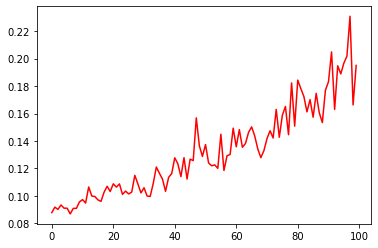

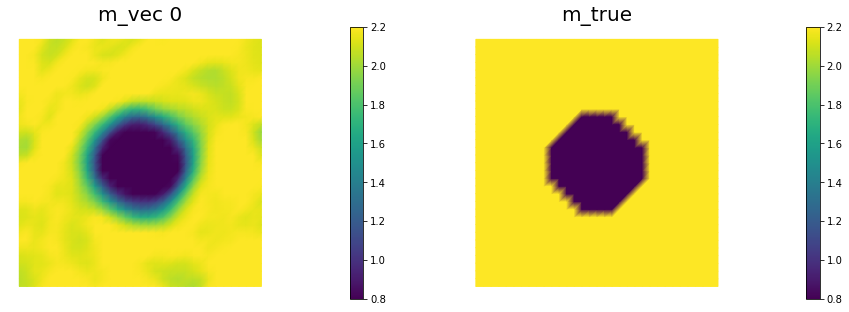

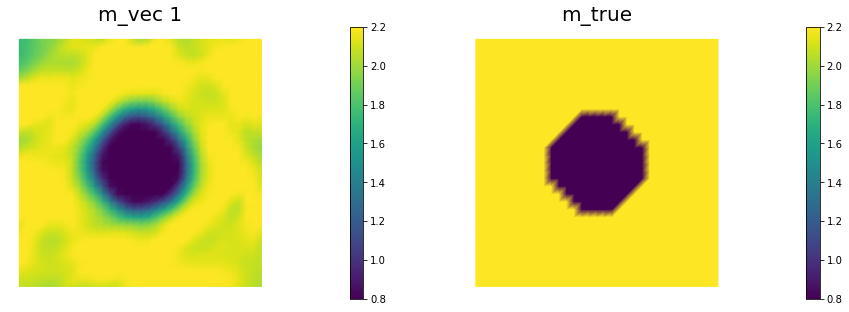

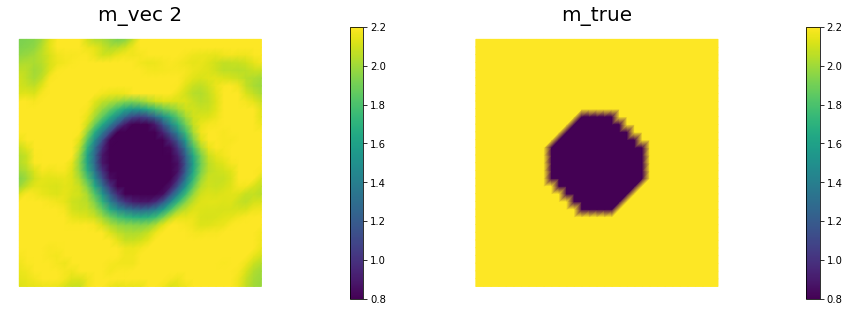

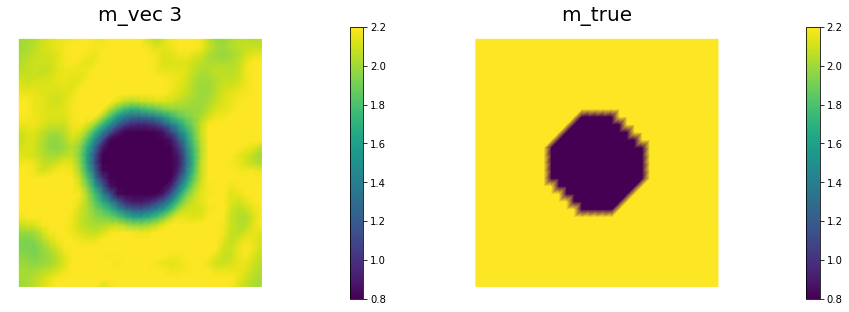

...

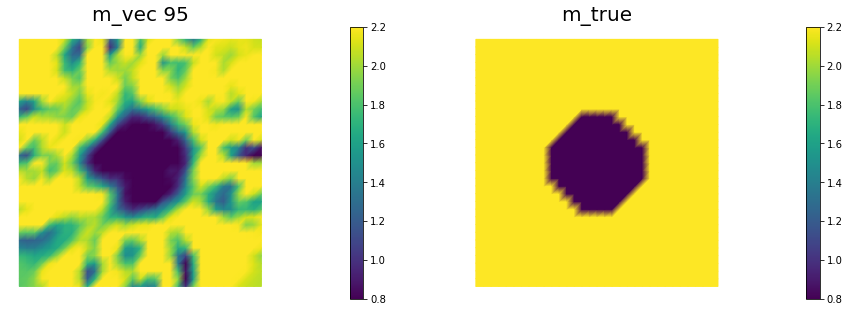

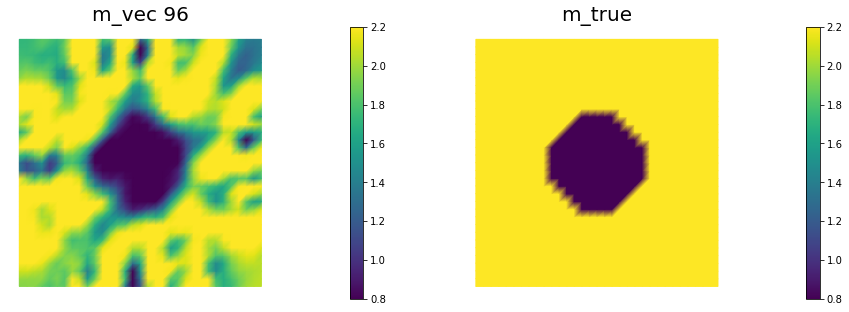

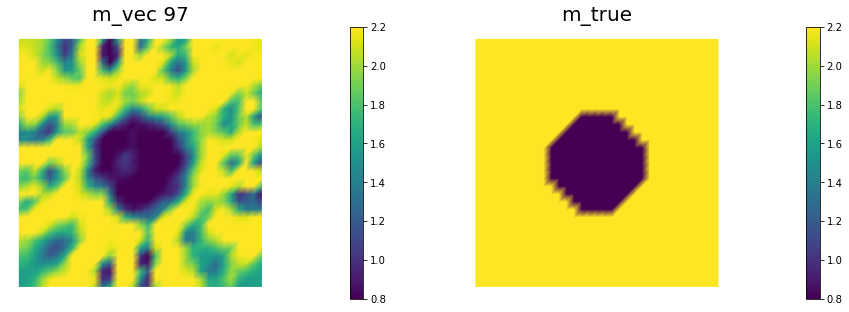

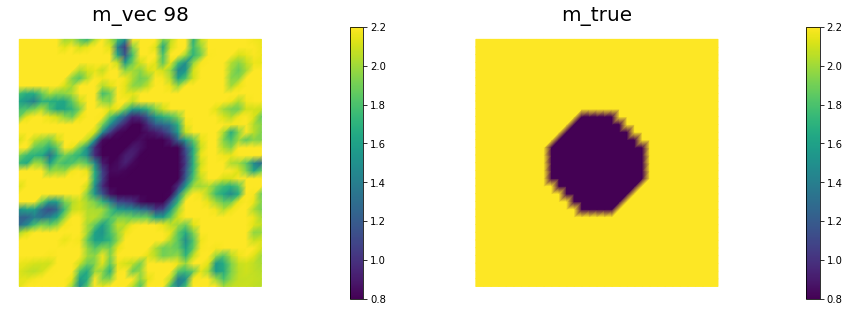

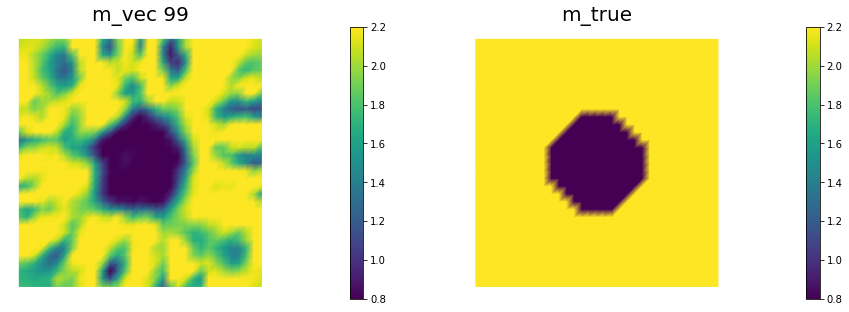

In [20]:
gamma = 1e-9

m_dim = []
Error = []
for r_dim in range(0,100):    
    # Active subspace
    W1 = (WW[:,:r_dim])
    W2 = (WW[:,r_dim:])

    Id = np.eye((nx+1)*(ny+1))

    # create mesh and define function spaces
    mesh = dl.UnitSquareMesh(nx, ny)
    Vm = dl.FunctionSpace(mesh, 'Lagrange', 1)
    Vu = dl.FunctionSpace(mesh, 'Lagrange', 2)

    # The true and inverted parameter
    mtrue_expression = dl.Expression('std::log(2 + 7*(std::pow(std::pow(x[0] - 0.5,2) + std::pow(x[1] - 0.5,2),0.5) > 0.2))', degree=5)
    
    mtrue = dl.interpolate(mtrue_expression,Vm)
    m = dl.interpolate(dl.Expression("std::log(2.0)", degree=1),Vm)

    # define function for state and adjoint
    u = dl.Function(Vu)
    p = dl.Function(Vu)

    # define Trial and Test Functions
    u_trial, p_trial, m_trial = dl.TrialFunction(Vu), dl.TrialFunction(Vu), dl.TrialFunction(Vm)
    u_test, p_test, m_test = dl.TestFunction(Vu), dl.TestFunction(Vu), dl.TestFunction(Vm)

    # initialize input functions
    f = dl.Constant(1.0)
    u0 = dl.Constant(0.0)


    # set up dirichlet boundary conditions
    def boundary(x,on_boundary):
        return on_boundary

    bc_state = dl.DirichletBC(Vu, u0, boundary)
    bc_adj = dl.DirichletBC(Vu, dl.Constant(0.), boundary)


    # noise level
    noise_level = 0.05

    # weak form for setting up the synthetic observations
    a_goal = ufl.inner(ufl.exp(mtrue) * ufl.grad(u_trial), ufl.grad(u_test)) * ufl.dx
    L_goal = f * u_test * ufl.dx

    # solve the forward/state problem to generate synthetic observations
    goal_A, goal_b = dl.assemble_system(a_goal, L_goal, bc_state)

    utrue = dl.Function(Vu)
    dl.solve(goal_A, utrue.vector(), goal_b)

    ud = dl.Function(Vu)
    ud.assign(utrue)

    # perturb state solution and create synthetic measurements ud
    # ud = u + ||u||/SNR * random.normal
    MAX = ud.vector().norm("linf")
    noise = dl.Vector()
    goal_A.init_vector(noise,1)
    parRandom.normal(noise_level * MAX, noise)
    bc_adj.apply(noise)

    ud.vector().axpy(1., noise)

    # regularization parameter
    # gamma = 5e-8

    # weak for for setting up the misfit and regularization compoment of the cost
    W_equ   = ufl.inner(u_trial, u_test) * ufl.dx
    R_equ   = gamma * (ufl.inner(ufl.grad(m_trial), ufl.grad(m_test)) * ufl.dx +\
             ufl.inner(m_trial, m_test) * ufl.dx)

    W = dl.assemble(W_equ)
    R = dl.assemble(R_equ)


    # Modifying the matrix R to consider active subspace

    M_prior = gamma * (ufl.inner(ufl.grad(m_trial), ufl.grad(m_test)) * ufl.dx +\
             ufl.inner(m_trial, m_test) * ufl.dx)
    M_Prior = dl.assemble(M_prior).array()
    UU, SSS, VVH = np.linalg.svd(M_Prior);
    M_Prior_half = UU @ np.diag(np.sqrt(SSS)) @ VVH
    M_sum = M_Prior_half @  (Id - W1 @ W1.T) @ M_Prior_half.T
    
    S = PETSc.Mat().create()
    S.setSizes(R.array().shape)
    S.setType("aij")
    S.setUp()
    S.setValues(range(0,R.array().shape[0]),range(0,R.array().shape[1]), M_sum)
    S.assemble()

    Rmat = dl.as_backend_type(R).mat()
    rmap, cmap = Rmat.getLGMap()
    S.setLGMap(rmap, cmap)

    R = dl.Matrix(dl.PETScMatrix(S))

    # refine cost function
    def cost(u, ud, m, W, R):
        diff = u.vector() - ud.vector()
        reg = 0.5 * m.vector().inner(R*m.vector()) 
        misfit = 0.5 * diff.inner(W * diff)
        return [reg + misfit, misfit, reg]

    # weak form for setting up the state equation
    a_state = ufl.inner(ufl.exp(m) * ufl.grad(u_trial), ufl.grad(u_test)) * ufl.dx
    L_state = f * u_test * ufl.dx

    # weak form for setting up the adjoint equation
    a_adj = ufl.inner(ufl.exp(m) * ufl.grad(p_trial), ufl.grad(p_test)) * ufl.dx
    L_adj = -ufl.inner(u - ud, p_test) * ufl.dx

    # weak form for setting up matrices
    Wum_equ = ufl.inner(ufl.exp(m) * m_trial * ufl.grad(p_test), ufl.grad(p)) * ufl.dx
    C_equ   = ufl.inner(ufl.exp(m) * m_trial * ufl.grad(u), ufl.grad(u_test)) * ufl.dx
    Wmm_equ = ufl.inner(ufl.exp(m) * m_trial * m_test *  ufl.grad(u),  ufl.grad(p)) * ufl.dx

    M_equ   = ufl.inner(m_trial, m_test) * ufl.dx

    # assemble matrix M
    M = dl.assemble(M_equ) 


    # solve state equation
    state_A, state_b = dl.assemble_system (a_state, L_state, bc_state)
    dl.solve (state_A, u.vector(), state_b)

    # evaluate cost
    [cost_old, misfit_old, reg_old] = cost(u, ud, m, W, R)

    # Class HessianOperator to perform Hessian apply to a vector
    class HessianOperator():
        cgiter = 0
        def __init__(self, R, Wmm, C, A, adj_A, W, Wum, gauss_newton_approx=False):
            self.R = R
            self.Wmm = Wmm
            self.C = C
            self.A = A
            self.adj_A = adj_A
            self.W = W
            self.Wum = Wum
            self.gauss_newton_approx = gauss_newton_approx

            # incremental state
            self.du = dl.Vector()
            self.A.init_vector(self.du,0)

            # incremental adjoint
            self.dp = dl.Vector()
            self.adj_A.init_vector(self.dp,0)

            # auxiliary vectors
            self.CT_dp = dl.Vector()
            self.C.init_vector(self.CT_dp, 1)
            self.Wum_du = dl.Vector()
            self.Wum.init_vector(self.Wum_du, 1)

        def init_vector(self, v, dim):
            self.R.init_vector(v,dim)

        # Hessian performed on v, output as generic vector y
        def mult(self, v, y):
            self.cgiter += 1
            y.zero()
            if self.gauss_newton_approx:
                self.mult_GaussNewton(v,y)
            else:
                self.mult_Newton(v,y)

        # define (Gauss-Newton) Hessian apply H * v
        def mult_GaussNewton(self, v, y):

            # incremental forward
            rhs = -(self.C * v)
            bc_adj.apply(rhs)
            dl.solve (self.A, self.du, rhs)

            # incremental adjoint
            rhs = - (self.W * self.du)
            bc_adj.apply(rhs)
            dl.solve (self.adj_A, self.dp, rhs)

            # Reg/Prior term
            self.R.mult(v,y)

            # Misfit term
            self.C.transpmult(self.dp, self.CT_dp)
            y.axpy(1, self.CT_dp)

        # define (Newton) Hessian apply H * v
        def mult_Newton(self, v, y):

            # incremental forward
            rhs = -(self.C * v)
            bc_adj.apply(rhs)
            dl.solve (self.A, self.du, rhs)

            # incremental adjoint
            rhs = -(self.W * self.du) -  self.Wum * v
            bc_adj.apply(rhs)
            dl.solve (self.adj_A, self.dp, rhs)

            # Reg/Prior term
            self.R.mult(v,y)
            y.axpy(1., self.Wmm*v)

            # Misfit term
            self.C.transpmult(self.dp, self.CT_dp)
            y.axpy(1., self.CT_dp)
            self.Wum.transpmult(self.du, self.Wum_du)
            y.axpy(1., self.Wum_du)


    # define parameters for the optimization
    tol = 1e-10
    c = 1e-5
    maxiter = 40
    plot_on = False

    # initialize iter counters
    iter = 1
    total_cg_iter = 0
    converged = False

    # initializations
    g, m_delta = dl.Vector(), dl.Vector()
    R.init_vector(m_delta,0)
    R.init_vector(g,0)

    m_prev = dl.Function(Vm)

    print ("Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg")

    while iter <  maxiter and not converged:

        # assemble matrix C
        C =  dl.assemble(C_equ)

        # solve the adoint problem
        adjoint_A, adjoint_RHS = dl.assemble_system(a_adj, L_adj, bc_adj)
        dl.solve(adjoint_A, p.vector(), adjoint_RHS)

        # assemble W_ua and R
        Wum = dl.assemble (Wum_equ)
        Wmm = dl.assemble (Wmm_equ)

        # evaluate the  gradient
        CT_p = dl.Vector()
        C.init_vector(CT_p,1)
        C.transpmult(p.vector(), CT_p)
        MG = CT_p + R * m.vector()

        #print(type(MG))
        #print(type(M))
        dl.solve(M, g, MG)

        # calculate the norm of the gradient
        grad2 = g.inner(MG)
        gradnorm = math.sqrt(grad2)

        # set the CG tolerance (use Eisenstat–Walker termination criterion)
        if iter == 1:
            gradnorm_ini = gradnorm
        tolcg = min(0.5, math.sqrt(gradnorm/gradnorm_ini))

        # define the Hessian apply operator (with preconditioner)
        Hess_Apply = HessianOperator(R, Wmm, C, state_A, adjoint_A, W, Wum, gauss_newton_approx=(iter<6) )
        P = R + gamma * M
        Psolver = dl.PETScKrylovSolver("cg", amg_method())
        Psolver.set_operator(P)

        solver = CGSolverSteihaug()
        solver.set_operator(Hess_Apply)
        solver.set_preconditioner(Psolver)
        solver.parameters["rel_tolerance"] = tolcg
        solver.parameters["zero_initial_guess"] = True
        solver.parameters["print_level"] = -1

        # solve the Newton system H a_delta = - MG
        solver.solve(m_delta, -MG)
        total_cg_iter += Hess_Apply.cgiter

        # linesearch
        alpha = 1
        descent = 0
        no_backtrack = 0
        m_prev.assign(m)
        while descent == 0 and no_backtrack < 10:
            m.vector().axpy(alpha, m_delta )

            # solve the state/forward problem
            state_A, state_b = dl.assemble_system(a_state, L_state, bc_state)
            dl.solve(state_A, u.vector(), state_b)

            # evaluate cost
            [cost_new, misfit_new, reg_new] = cost(u, ud, m, W, R)

            # check if Armijo conditions are satisfied
            if cost_new < cost_old + alpha * c * MG.inner(m_delta):
                cost_old = cost_new
                descent = 1
            else:
                no_backtrack += 1
                alpha *= 0.5
                m.assign(m_prev)  # reset a

        # calculate sqrt(-G * D)
        graddir = math.sqrt(- MG.inner(m_delta) )

        sp = ""
        print( "%2d %2s %2d %3s %8.5e %1s %8.5e %1s %8.5e %1s %8.5e %1s %8.5e %1s %5.2f %1s %5.3e" % \
            (iter, sp, Hess_Apply.cgiter, sp, cost_new, sp, misfit_new, sp, reg_new, sp, \
             graddir, sp, gradnorm, sp, alpha, sp, tolcg) )

        if plot_on:
            nb.multi1_plot([m,u,p], ["m","u","p"], same_colorbar=False)
            plt.show()

        # check for convergence
        if gradnorm < tol and iter > 1:
            converged = True
            print( "Newton's method converged in ",iter,"  iterations")
            print( "Total number of CG iterations: ", total_cg_iter)

        iter += 1

    if not converged:
        print( "Newton's method did not converge in ", maxiter, " iterations")
    m_dim.append(m.vector().get_local())
    
    Error.append(np.linalg.norm(mtrue.vector().get_local() - m.vector().get_local()) / np.linalg.norm(mtrue.vector().get_local()))

plt.plot(Error, color = 'r')
Error

m_dim = np.array(m_dim)

for r_dim in range(100):
    m_vec = dl.Function(Vm)
    m_vec_err = dl.Function(Vm)
    m_vec.vector().set_local(m_dim[r_dim,:])
    m_vec_err.vector().set_local(m_dim[r_dim,:]-mtrue.vector().get_local())
    # nb.multi1_plot([m_vec, mtrue,m_vec_err], ["m_vec", 'm_true','Error'],same_colorbar=False, vmin = 0.8, vmax = 2.2)
    nb.multi1_plot([m_vec, mtrue], ["m_vec %d" %(r_dim), 'm_true'],same_colorbar=False, vmin = 0.8, vmax = 2.2)

In [ ]:
gamma = 1e-10

m_dim = []
Error = []
for r_dim in range(0,100):    
    # Active subspace
    W1 = (WW[:,:r_dim])
    W2 = (WW[:,r_dim:])

    Id = np.eye((nx+1)*(ny+1))

    # create mesh and define function spaces
    mesh = dl.UnitSquareMesh(nx, ny)
    Vm = dl.FunctionSpace(mesh, 'Lagrange', 1)
    Vu = dl.FunctionSpace(mesh, 'Lagrange', 2)

    # The true and inverted parameter
    mtrue_expression = dl.Expression('std::log(2 + 7*(std::pow(std::pow(x[0] - 0.5,2) + std::pow(x[1] - 0.5,2),0.5) > 0.2))', degree=5)
    
    mtrue = dl.interpolate(mtrue_expression,Vm)
    m = dl.interpolate(dl.Expression("std::log(2.0)", degree=1),Vm)

    # define function for state and adjoint
    u = dl.Function(Vu)
    p = dl.Function(Vu)

    # define Trial and Test Functions
    u_trial, p_trial, m_trial = dl.TrialFunction(Vu), dl.TrialFunction(Vu), dl.TrialFunction(Vm)
    u_test, p_test, m_test = dl.TestFunction(Vu), dl.TestFunction(Vu), dl.TestFunction(Vm)

    # initialize input functions
    f = dl.Constant(1.0)
    u0 = dl.Constant(0.0)


    # set up dirichlet boundary conditions
    def boundary(x,on_boundary):
        return on_boundary

    bc_state = dl.DirichletBC(Vu, u0, boundary)
    bc_adj = dl.DirichletBC(Vu, dl.Constant(0.), boundary)


    # noise level
    noise_level = 0.05

    # weak form for setting up the synthetic observations
    a_goal = ufl.inner(ufl.exp(mtrue) * ufl.grad(u_trial), ufl.grad(u_test)) * ufl.dx
    L_goal = f * u_test * ufl.dx

    # solve the forward/state problem to generate synthetic observations
    goal_A, goal_b = dl.assemble_system(a_goal, L_goal, bc_state)

    utrue = dl.Function(Vu)
    dl.solve(goal_A, utrue.vector(), goal_b)

    ud = dl.Function(Vu)
    ud.assign(utrue)

    # perturb state solution and create synthetic measurements ud
    # ud = u + ||u||/SNR * random.normal
    MAX = ud.vector().norm("linf")
    noise = dl.Vector()
    goal_A.init_vector(noise,1)
    parRandom.normal(noise_level * MAX, noise)
    bc_adj.apply(noise)

    ud.vector().axpy(1., noise)

    # regularization parameter
    # gamma = 5e-8

    # weak for for setting up the misfit and regularization compoment of the cost
    W_equ   = ufl.inner(u_trial, u_test) * ufl.dx
    R_equ   = gamma * (ufl.inner(ufl.grad(m_trial), ufl.grad(m_test)) * ufl.dx +\
             ufl.inner(m_trial, m_test) * ufl.dx)

    W = dl.assemble(W_equ)
    R = dl.assemble(R_equ)


    # Modifying the matrix R to consider active subspace

    M_prior = gamma * (ufl.inner(ufl.grad(m_trial), ufl.grad(m_test)) * ufl.dx +\
             ufl.inner(m_trial, m_test) * ufl.dx)
    M_Prior = dl.assemble(M_prior).array()
    UU, SSS, VVH = np.linalg.svd(M_Prior);
    M_Prior_half = UU @ np.diag(np.sqrt(SSS)) @ VVH
    M_sum = M_Prior_half @  (Id - W1 @ W1.T) @ M_Prior_half.T
    
    S = PETSc.Mat().create()
    S.setSizes(R.array().shape)
    S.setType("aij")
    S.setUp()
    S.setValues(range(0,R.array().shape[0]),range(0,R.array().shape[1]), M_sum)
    S.assemble()

    Rmat = dl.as_backend_type(R).mat()
    rmap, cmap = Rmat.getLGMap()
    S.setLGMap(rmap, cmap)

    R = dl.Matrix(dl.PETScMatrix(S))

    # refine cost function
    def cost(u, ud, m, W, R):
        diff = u.vector() - ud.vector()
        reg = 0.5 * m.vector().inner(R*m.vector()) 
        misfit = 0.5 * diff.inner(W * diff)
        return [reg + misfit, misfit, reg]

    # weak form for setting up the state equation
    a_state = ufl.inner(ufl.exp(m) * ufl.grad(u_trial), ufl.grad(u_test)) * ufl.dx
    L_state = f * u_test * ufl.dx

    # weak form for setting up the adjoint equation
    a_adj = ufl.inner(ufl.exp(m) * ufl.grad(p_trial), ufl.grad(p_test)) * ufl.dx
    L_adj = -ufl.inner(u - ud, p_test) * ufl.dx

    # weak form for setting up matrices
    Wum_equ = ufl.inner(ufl.exp(m) * m_trial * ufl.grad(p_test), ufl.grad(p)) * ufl.dx
    C_equ   = ufl.inner(ufl.exp(m) * m_trial * ufl.grad(u), ufl.grad(u_test)) * ufl.dx
    Wmm_equ = ufl.inner(ufl.exp(m) * m_trial * m_test *  ufl.grad(u),  ufl.grad(p)) * ufl.dx

    M_equ   = ufl.inner(m_trial, m_test) * ufl.dx

    # assemble matrix M
    M = dl.assemble(M_equ) 


    # solve state equation
    state_A, state_b = dl.assemble_system (a_state, L_state, bc_state)
    dl.solve (state_A, u.vector(), state_b)

    # evaluate cost
    [cost_old, misfit_old, reg_old] = cost(u, ud, m, W, R)

    # Class HessianOperator to perform Hessian apply to a vector
    class HessianOperator():
        cgiter = 0
        def __init__(self, R, Wmm, C, A, adj_A, W, Wum, gauss_newton_approx=False):
            self.R = R
            self.Wmm = Wmm
            self.C = C
            self.A = A
            self.adj_A = adj_A
            self.W = W
            self.Wum = Wum
            self.gauss_newton_approx = gauss_newton_approx

            # incremental state
            self.du = dl.Vector()
            self.A.init_vector(self.du,0)

            # incremental adjoint
            self.dp = dl.Vector()
            self.adj_A.init_vector(self.dp,0)

            # auxiliary vectors
            self.CT_dp = dl.Vector()
            self.C.init_vector(self.CT_dp, 1)
            self.Wum_du = dl.Vector()
            self.Wum.init_vector(self.Wum_du, 1)

        def init_vector(self, v, dim):
            self.R.init_vector(v,dim)

        # Hessian performed on v, output as generic vector y
        def mult(self, v, y):
            self.cgiter += 1
            y.zero()
            if self.gauss_newton_approx:
                self.mult_GaussNewton(v,y)
            else:
                self.mult_Newton(v,y)

        # define (Gauss-Newton) Hessian apply H * v
        def mult_GaussNewton(self, v, y):

            # incremental forward
            rhs = -(self.C * v)
            bc_adj.apply(rhs)
            dl.solve (self.A, self.du, rhs)

            # incremental adjoint
            rhs = - (self.W * self.du)
            bc_adj.apply(rhs)
            dl.solve (self.adj_A, self.dp, rhs)

            # Reg/Prior term
            self.R.mult(v,y)

            # Misfit term
            self.C.transpmult(self.dp, self.CT_dp)
            y.axpy(1, self.CT_dp)

        # define (Newton) Hessian apply H * v
        def mult_Newton(self, v, y):

            # incremental forward
            rhs = -(self.C * v)
            bc_adj.apply(rhs)
            dl.solve (self.A, self.du, rhs)

            # incremental adjoint
            rhs = -(self.W * self.du) -  self.Wum * v
            bc_adj.apply(rhs)
            dl.solve (self.adj_A, self.dp, rhs)

            # Reg/Prior term
            self.R.mult(v,y)
            y.axpy(1., self.Wmm*v)

            # Misfit term
            self.C.transpmult(self.dp, self.CT_dp)
            y.axpy(1., self.CT_dp)
            self.Wum.transpmult(self.du, self.Wum_du)
            y.axpy(1., self.Wum_du)


    # define parameters for the optimization
    tol = 1e-10
    c = 1e-5
    maxiter = 40
    plot_on = False

    # initialize iter counters
    iter = 1
    total_cg_iter = 0
    converged = False

    # initializations
    g, m_delta = dl.Vector(), dl.Vector()
    R.init_vector(m_delta,0)
    R.init_vector(g,0)

    m_prev = dl.Function(Vm)

    print ("Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg")

    while iter <  maxiter and not converged:

        # assemble matrix C
        C =  dl.assemble(C_equ)

        # solve the adoint problem
        adjoint_A, adjoint_RHS = dl.assemble_system(a_adj, L_adj, bc_adj)
        dl.solve(adjoint_A, p.vector(), adjoint_RHS)

        # assemble W_ua and R
        Wum = dl.assemble (Wum_equ)
        Wmm = dl.assemble (Wmm_equ)

        # evaluate the  gradient
        CT_p = dl.Vector()
        C.init_vector(CT_p,1)
        C.transpmult(p.vector(), CT_p)
        MG = CT_p + R * m.vector()

        #print(type(MG))
        #print(type(M))
        dl.solve(M, g, MG)

        # calculate the norm of the gradient
        grad2 = g.inner(MG)
        gradnorm = math.sqrt(grad2)

        # set the CG tolerance (use Eisenstat–Walker termination criterion)
        if iter == 1:
            gradnorm_ini = gradnorm
        tolcg = min(0.5, math.sqrt(gradnorm/gradnorm_ini))

        # define the Hessian apply operator (with preconditioner)
        Hess_Apply = HessianOperator(R, Wmm, C, state_A, adjoint_A, W, Wum, gauss_newton_approx=(iter<6) )
        P = R + gamma * M
        Psolver = dl.PETScKrylovSolver("cg", amg_method())
        Psolver.set_operator(P)

        solver = CGSolverSteihaug()
        solver.set_operator(Hess_Apply)
        solver.set_preconditioner(Psolver)
        solver.parameters["rel_tolerance"] = tolcg
        solver.parameters["zero_initial_guess"] = True
        solver.parameters["print_level"] = -1

        # solve the Newton system H a_delta = - MG
        solver.solve(m_delta, -MG)
        total_cg_iter += Hess_Apply.cgiter

        # linesearch
        alpha = 1
        descent = 0
        no_backtrack = 0
        m_prev.assign(m)
        while descent == 0 and no_backtrack < 10:
            m.vector().axpy(alpha, m_delta )

            # solve the state/forward problem
            state_A, state_b = dl.assemble_system(a_state, L_state, bc_state)
            dl.solve(state_A, u.vector(), state_b)

            # evaluate cost
            [cost_new, misfit_new, reg_new] = cost(u, ud, m, W, R)

            # check if Armijo conditions are satisfied
            if cost_new < cost_old + alpha * c * MG.inner(m_delta):
                cost_old = cost_new
                descent = 1
            else:
                no_backtrack += 1
                alpha *= 0.5
                m.assign(m_prev)  # reset a

        # calculate sqrt(-G * D)
        graddir = math.sqrt(- MG.inner(m_delta) )

        sp = ""
        print( "%2d %2s %2d %3s %8.5e %1s %8.5e %1s %8.5e %1s %8.5e %1s %8.5e %1s %5.2f %1s %5.3e" % \
            (iter, sp, Hess_Apply.cgiter, sp, cost_new, sp, misfit_new, sp, reg_new, sp, \
             graddir, sp, gradnorm, sp, alpha, sp, tolcg) )

        if plot_on:
            nb.multi1_plot([m,u,p], ["m","u","p"], same_colorbar=False)
            plt.show()

        # check for convergence
        if gradnorm < tol and iter > 1:
            converged = True
            print( "Newton's method converged in ",iter,"  iterations")
            print( "Total number of CG iterations: ", total_cg_iter)

        iter += 1

    if not converged:
        print( "Newton's method did not converge in ", maxiter, " iterations")
    m_dim.append(m.vector().get_local())
    
    Error.append(np.linalg.norm(mtrue.vector().get_local() - m.vector().get_local()) / np.linalg.norm(mtrue.vector().get_local()))

plt.plot(Error, color = 'r')
Error

m_dim = np.array(m_dim)

for r_dim in range(100):
    m_vec = dl.Function(Vm)
    m_vec_err = dl.Function(Vm)
    m_vec.vector().set_local(m_dim[r_dim,:])
    m_vec_err.vector().set_local(m_dim[r_dim,:]-mtrue.vector().get_local())
    # nb.multi1_plot([m_vec, mtrue,m_vec_err], ["m_vec", 'm_true','Error'],same_colorbar=False, vmin = 0.8, vmax = 2.2)
    nb.multi1_plot([m_vec, mtrue], ["m_vec %d" %(r_dim), 'm_true'],same_colorbar=False, vmin = 0.8, vmax = 2.2)

Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.12426e-05   1.12424e-05   1.04875e-10   1.56475e-02   3.79244e-04    1.00   5.000e-01
 2     1     7.68486e-07   7.68299e-07   1.86582e-10   4.67894e-03   5.34094e-05    1.00   3.753e-01
 3     1     3.01255e-07   3.01036e-07   2.19358e-10   9.69752e-04   7.10513e-06    1.00   1.369e-01
 4    10     1.48976e-07   1.48238e-07   7.37409e-10   5.76551e-04   9.82684e-07    0.50   5.090e-02
 5     3     1.27661e-07   1.26773e-07   8.88607e-10   2.04791e-04   8.75142e-07    1.00   4.804e-02
 6    56     1.24914e-07   1.23415e-07   1.49856e-09   3.25956e-04   2.21403e-07    0.03   2.416e-02
 7    29     1.13326e-07   1.09376e-07   3.95010e-09   1.80069e-04   2.16143e-07    1.00   2.387e-02
 8     3     1.10450e-07   1.06541e-07   3.90899e-09   7.44426e-05   3.39919e-07    1.00   2.994e-02
 9    76     1.08962e-07   1.03828e-07   5.13376e-09   5.50902e-05   5.71182e-08    1.00   1.22

 8     7     1.04034e-07   9.87945e-08   5.23995e-09   3.21912e-05   1.54614e-07    1.00   2.019e-02
 9    165     1.03667e-07   9.86553e-08   5.01186e-09   2.87095e-05   2.24549e-08    1.00   7.695e-03
10     7     1.03622e-07   9.86112e-08   5.01065e-09   9.52490e-06   4.85728e-08    1.00   1.132e-02
11    214     1.03618e-07   9.86206e-08   4.99779e-09   2.65070e-06   2.35953e-09    1.00   2.494e-03
12    71     1.03618e-07   9.86208e-08   4.99761e-09   1.10250e-07   5.09283e-10    1.00   1.159e-03
13    372     1.03618e-07   9.86207e-08   4.99768e-09   1.21560e-08   8.42303e-12    1.00   1.490e-04
Newton's method converged in  13   iterations
Total number of CG iterations:  983
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.15001e-05   1.15001e-05   3.26983e-12   1.56632e-02   3.79957e-04    1.00   5.000e-01
 2     1     7.67532e-07   7.67530e-07   2.66256e-12   4.73814e-03   5.34537e-05    1.00   3.751e-01
 3     1  

 7    118     1.03611e-07   9.95567e-08   4.05413e-09   3.77389e-05   4.55325e-08    1.00   1.095e-02
 8    212     1.03582e-07   9.92981e-08   4.28418e-09   7.56102e-06   7.06459e-09    1.00   4.315e-03
 9    176     1.03582e-07   9.92971e-08   4.28517e-09   2.58013e-07   6.97911e-10    1.00   1.356e-03
10    510     1.03582e-07   9.92969e-08   4.28531e-09   1.49595e-08   1.23863e-11    1.00   1.807e-04
Newton's method converged in  10   iterations
Total number of CG iterations:  1165
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.26097e-05   1.26097e-05   2.86388e-12   1.56213e-02   3.79989e-04    1.00   5.000e-01
 2     1     8.42477e-07   8.42474e-07   2.59348e-12   4.96274e-03   5.59821e-05    1.00   3.838e-01
 3     1     2.38768e-07   2.38765e-07   2.50010e-12   1.10211e-03   7.67832e-06    1.00   1.422e-01
 4    15     1.34791e-07   1.34576e-07   2.14828e-10   4.65087e-04   1.03798e-06    1.00   5.226e-02
 5    19

12    516     1.00935e-07   9.65483e-08   4.38692e-09   1.04131e-07   5.25084e-11    1.00   3.720e-04
Newton's method converged in  12   iterations
Total number of CG iterations:  1307
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.22563e-05   1.22563e-05   2.02536e-12   1.56232e-02   3.79743e-04    1.00   5.000e-01
 2     1     7.83099e-07   7.83097e-07   1.90868e-12   4.89678e-03   5.50241e-05    1.00   3.807e-01
 3     1     2.10355e-07   2.10353e-07   1.87805e-12   1.07308e-03   7.41333e-06    1.00   1.397e-01
 4    19     1.22060e-07   1.21864e-07   1.95555e-10   4.27567e-04   9.04510e-07    1.00   4.880e-02
 5    47     1.08634e-07   1.07750e-07   8.84178e-10   1.66418e-04   2.69470e-07    1.00   2.664e-02
 6    109     1.03829e-07   1.00188e-07   3.64124e-09   1.02453e-04   1.14048e-07    1.00   1.733e-02
 7    55     1.03357e-07   9.96976e-08   3.65933e-09   3.05086e-05   7.00707e-08    1.00   1.358e-02
 8    170 

12    270     1.06103e-07   1.01858e-07   4.24501e-09   8.45217e-06   5.66567e-09    1.00   3.864e-03
13     9     1.06103e-07   1.01858e-07   4.24501e-09   1.16133e-06   6.41846e-09    1.00   4.113e-03
14    414     1.06103e-07   1.01854e-07   4.24874e-09   2.66943e-07   1.82855e-10    1.00   6.942e-04
15    291     1.06103e-07   1.01854e-07   4.24874e-09   8.72248e-10   3.93282e-12    1.00   1.018e-04
Newton's method converged in  15   iterations
Total number of CG iterations:  1518
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.22057e-05   1.22057e-05   1.83491e-12   1.56242e-02   3.79846e-04    1.00   5.000e-01
 2     1     7.56240e-07   7.56239e-07   1.72752e-12   4.88775e-03   5.50496e-05    1.00   3.807e-01
 3     1     2.12535e-07   2.12533e-07   1.70091e-12   1.04500e-03   7.26428e-06    1.00   1.383e-01
 4    10     1.33509e-07   1.33506e-07   3.04473e-12   4.20517e-04   8.34336e-07    1.00   4.687e-02
 5    17 

 7    445     1.12274e-07   1.11904e-07   3.69215e-10   3.85192e-04   1.26711e-07    0.00   1.827e-02
 8    171     1.02612e-07   9.83423e-08   4.26949e-09   1.50745e-04   1.32823e-07    1.00   1.871e-02
 9    14     1.02017e-07   9.77514e-08   4.26552e-09   3.49461e-05   1.21464e-07    1.00   1.789e-02
10    252     1.01450e-07   9.75132e-08   3.93673e-09   3.36247e-05   2.74916e-08    1.00   8.510e-03
11    115     1.01447e-07   9.75045e-08   3.94206e-09   2.58245e-06   7.67668e-09    1.00   4.497e-03
12    321     1.01446e-07   9.75015e-08   3.94488e-09   5.84047e-07   4.54271e-10    1.00   1.094e-03
13    394     1.01446e-07   9.75015e-08   3.94490e-09   7.07227e-09   1.25552e-11    1.00   1.819e-04
Newton's method converged in  13   iterations
Total number of CG iterations:  1753
Nit   CGit   cost          misfit        reg           sqrt(-G*D)    ||grad||       alpha  tolcg
 1     1     1.21716e-05   1.21716e-05   1.76200e-12   1.56014e-02   3.79333e-04    1.00   5.000e-01
 2    